<a href="https://colab.research.google.com/github/VitalyGladyshev/Medicine-HG-COPD/blob/main/Med_EDA_HR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Разведочный анализ EDA - ССР сердечно-сосудистый риск


Проанализированы раздельно группы 1, 2 и совместно 1-2

Данные предварительно очищены, разбиты на группы в отдельных csv файлах

## Группа 1

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [ ]:
data_1 = pd.read_csv("ikm_start_1.csv")
data_1.head()

,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,вдадд,...,S,Imax,Imax_S,эндотелин,хс,пол1,возраст,стадия_АГ,степень_АГ,ССР
0,2.207,71,5,9,34.0,49.0,68,112,11.5,13.0,...,657,122,0.185693,2.207,4.0,0,55,2,2,3
1,0.600,72,6,10,34.1,49.2,69,114,11.5,13.4,...,2524,851,0.337163,0.600,4.1,0,46,2,2,2
2,14.775,73,7,11,35.6,49.4,70,115,11.5,13.1,...,657,122,0.185693,14.775,4.2,0,45,2,2,2
3,1.647,74,8,12,37.9,49.0,71,118,11.5,13.7,...,702,130,0.185185,1.647,4.3,0,61,3,2,3
4,12.706,75,5,13,38.5,50.0,72,120,11.5,13.8,...,624,115,0.184295,12.706,4.4,0,78,3,2,3


In [ ]:
data_1.describe()

,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,вдадд,...,S,Imax,Imax_S,эндотелин,хс,пол1,возраст,стадия_АГ,степень_АГ,ССР
count,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,...,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000,52.000000
mean,1.983538,70.961538,6.250000,10.846154,36.426923,52.163462,72.865385,124.461538,12.342308,13.601923,...,1728.134615,431.076923,0.224490,4.772000,6.030769,0.365385,58.365385,2.442308,1.730769,2.634615
std,4.235909,8.207986,1.135436,1.588989,2.017484,3.456510,3.503661,11.090469,0.680930,0.596884,...,966.259861,402.954765,0.094786,3.676891,1.413456,0.486236,10.109264,0.725271,0.597885,0.561121
min,-1.000000,58.000000,5.000000,9.000000,34.000000,49.000000,68.000000,112.000000,11.500000,13.000000,...,624.000000,101.000000,0.116349,0.600000,3.600000,0.000000,35.000000,1.000000,1.000000,1.000000
25%,-1.000000,65.000000,5.000000,9.000000,34.200000,49.200000,70.000000,115.000000,11.500000,13.100000,...,691.000000,130.000000,0.180562,1.539750,4.875000,0.000000,51.750000,2.000000,1.000000,2.000000
50%,0.947500,68.500000,6.000000,11.000000,37.000000,50.050000,72.500000,121.500000,12.450000,13.400000,...,1882.500000,345.500000,0.185693,4.000000,6.050000,0.000000,57.000000,3.000000,2.000000,3.000000
75%,2.389250,76.250000,7.000000,12.000000,38.500000,55.500000,76.000000,130.000000,12.925000,13.800000,...,2305.000000,417.000000,0.218364,7.225000,7.225000,1.000000,66.250000,3.000000,2.000000,3.000000
max,14.775000,91.000000,8.000000,14.000000,39.200000,58.400000,79.000000,147.000000,13.400000,15.100000,...,4213.000000,1814.000000,0.622298,14.775000,8.400000,1.000000,78.000000,3.000000,3.000000,4.000000


In [ ]:
data_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52 entries, 0 to 51
Data columns (total 46 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   эндотели    52 non-null     float64
 1   ЧСС         52 non-null     int64  
 2   дадпу       52 non-null     int64  
 3   садсу       52 non-null     int64  
 4   дадуп       52 non-null     float64
 5   садуп       52 non-null     float64
 6   дадн        52 non-null     int64  
 7   садн        52 non-null     int64  
 8   вдадн       52 non-null     float64
 9   вдадд       52 non-null     float64
 10  всадн       52 non-null     float64
 11  всадд       52 non-null     float64
 12  сад1        52 non-null     int64  
 13  дад1        52 non-null     int64  
 14  E_A         52 non-null     float64
 15  СрДЛА       52 non-null     float64
 16  ТС_ПЖ       52 non-null     float64
 17  ПП          52 non-null     int64  
 18  IVRT        52 non-null     int64  
 19  E_A_ЛЖ      52 non-null     flo

<Axes: >

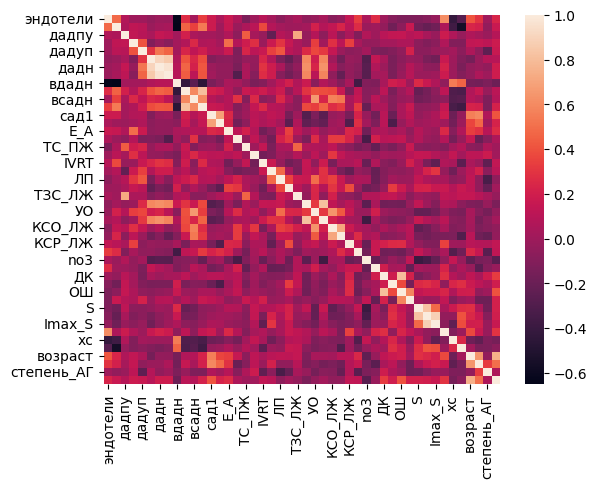

In [ ]:
sns.heatmap(data_1.corr(), annot=False)

<Axes: >

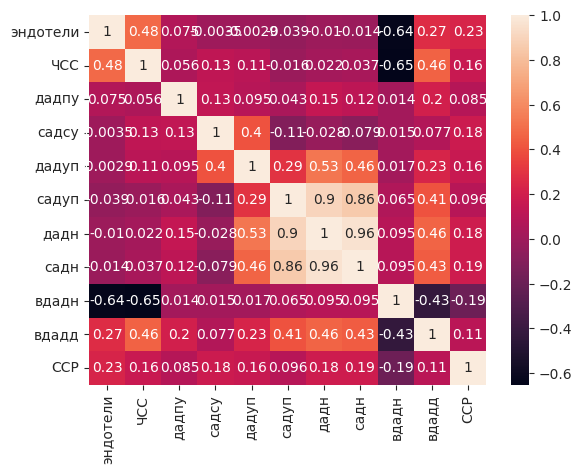

In [ ]:
sns.heatmap(data_1[[
'эндотели',
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

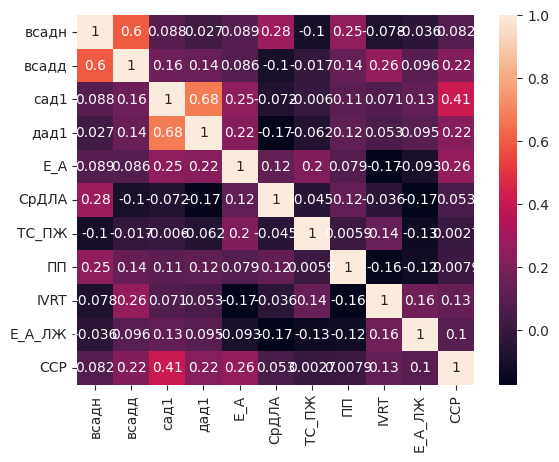

In [ ]:
sns.heatmap(data_1[[
'всадн',
'всадд',
'сад1',
'дад1',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

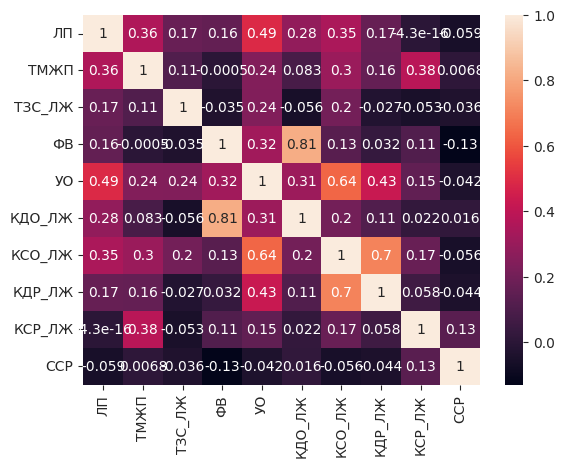

In [ ]:
sns.heatmap(data_1[[
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',
'УО',
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

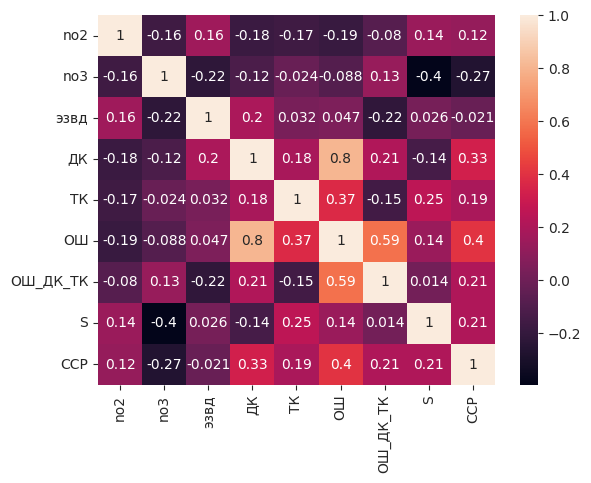

In [ ]:
sns.heatmap(data_1[[
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',
'S',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

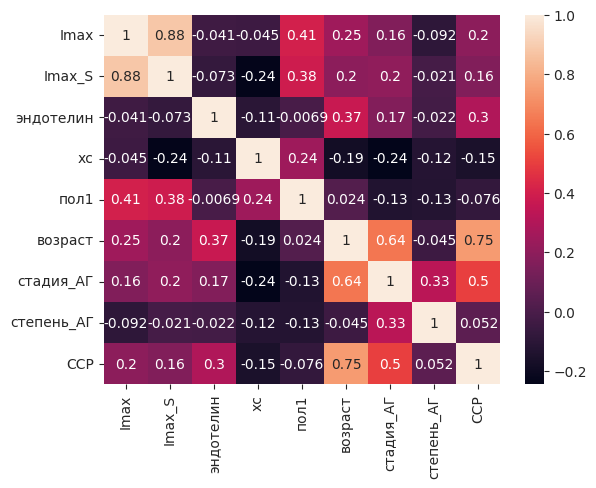

In [ ]:
sns.heatmap(data_1[[
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

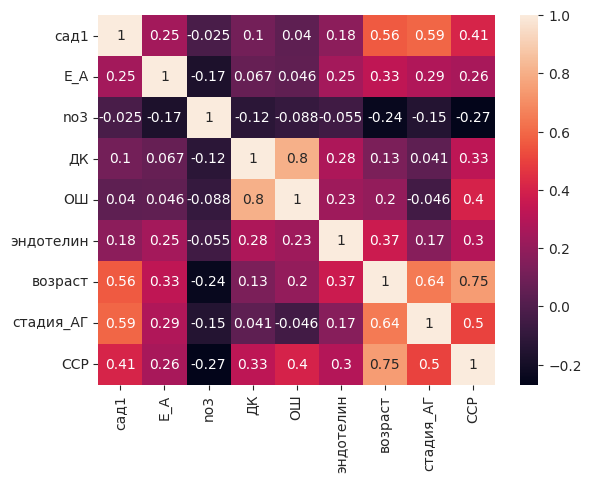

In [ ]:
sns.heatmap(data_1[[
'сад1',
'E_A',
'no3',
'ДК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                ]].corr(), annot=True)

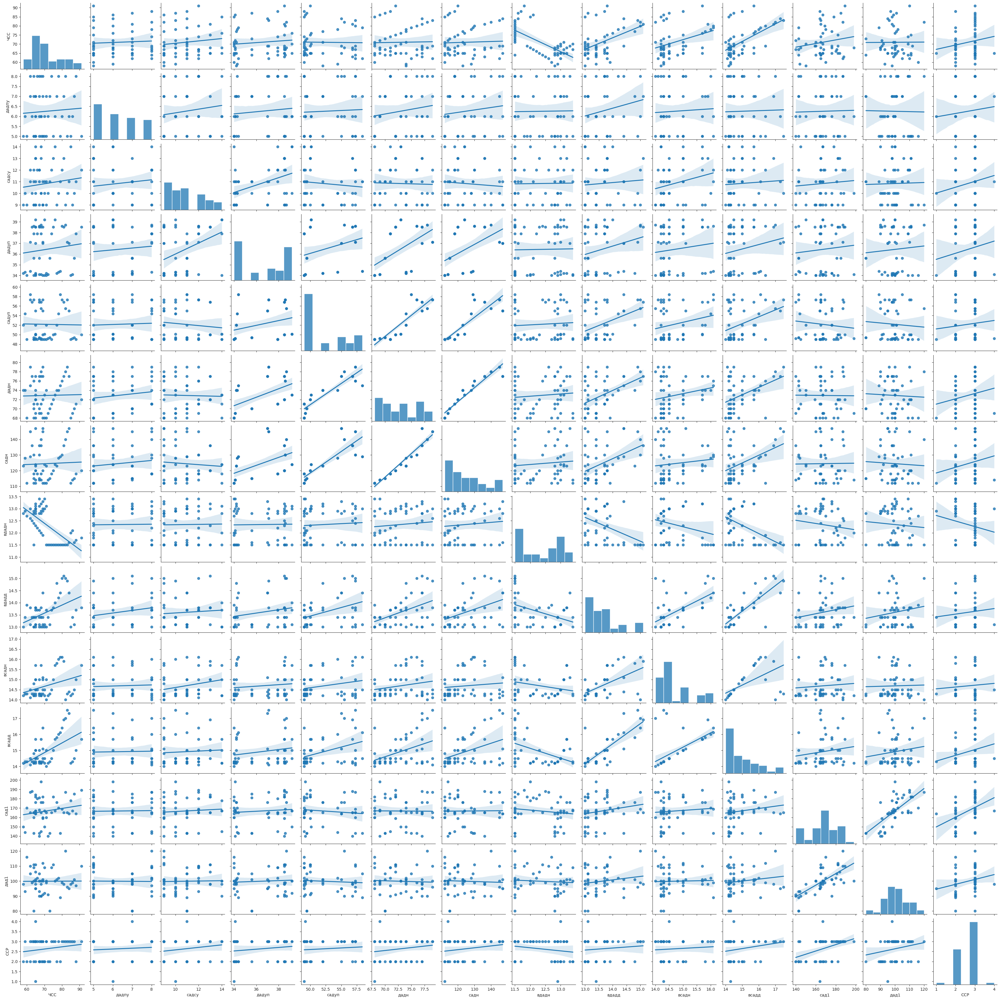

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                    ]], kind="reg")
plt.show()

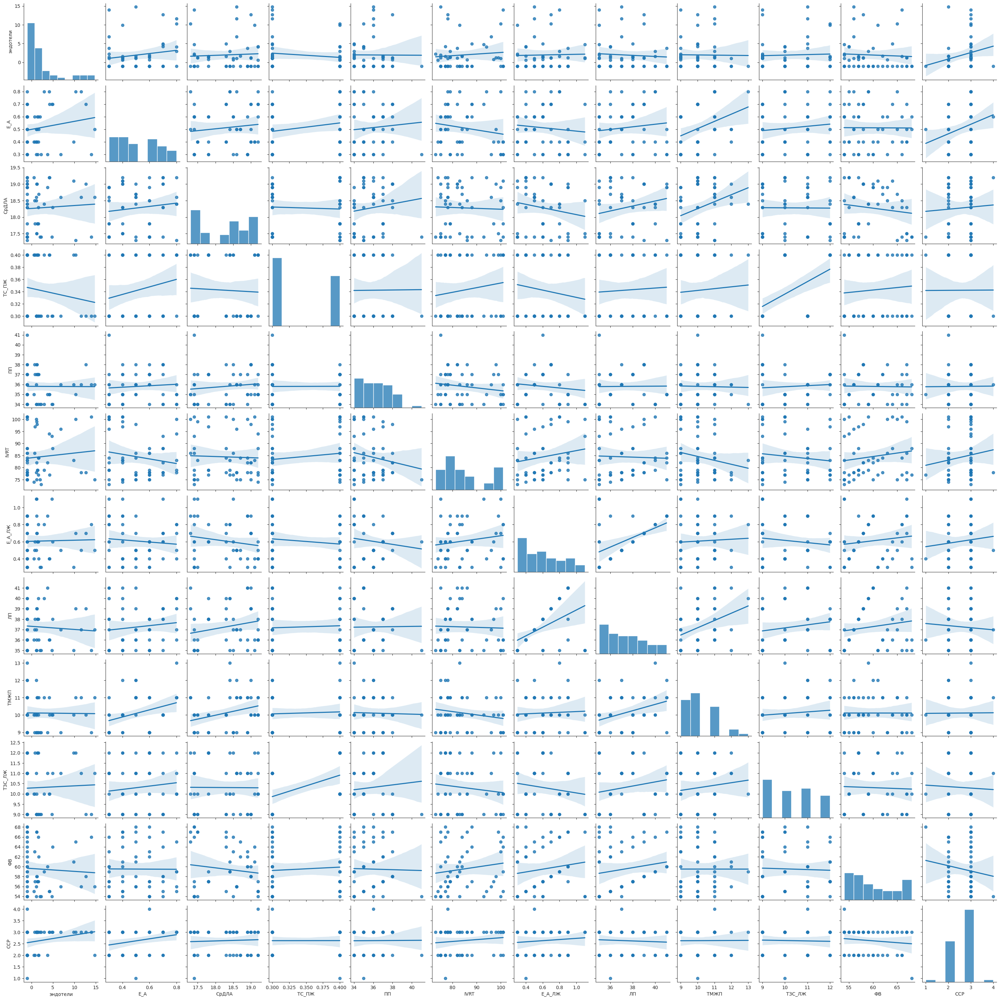

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                    ]], kind="reg")
plt.show()

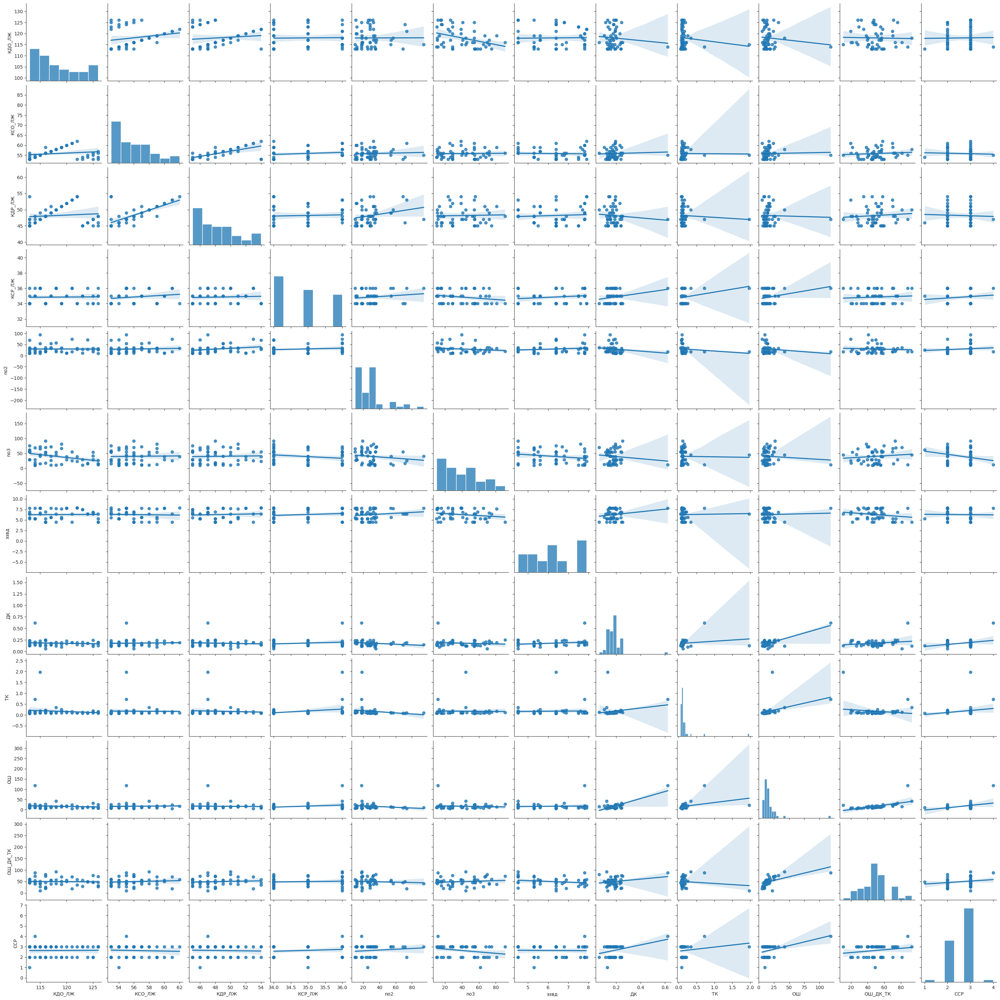

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                    ]], kind="reg")
plt.show()

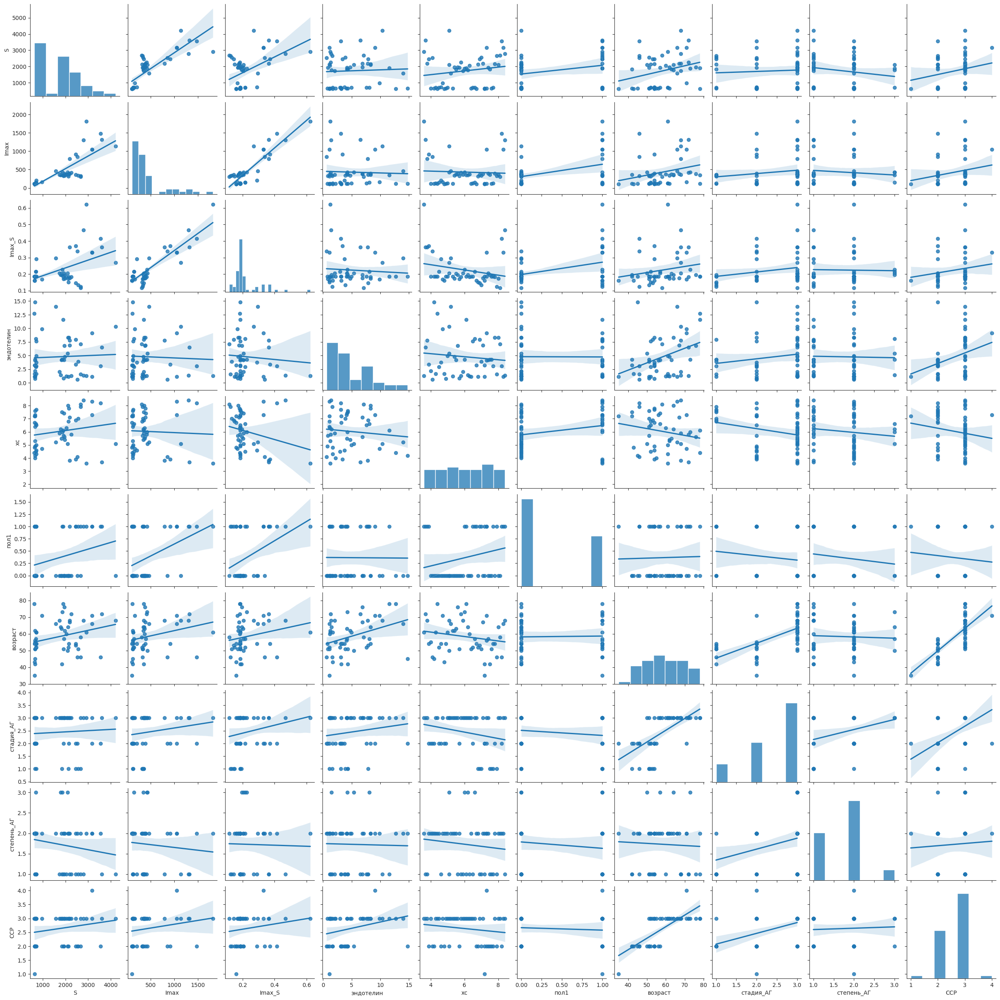

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

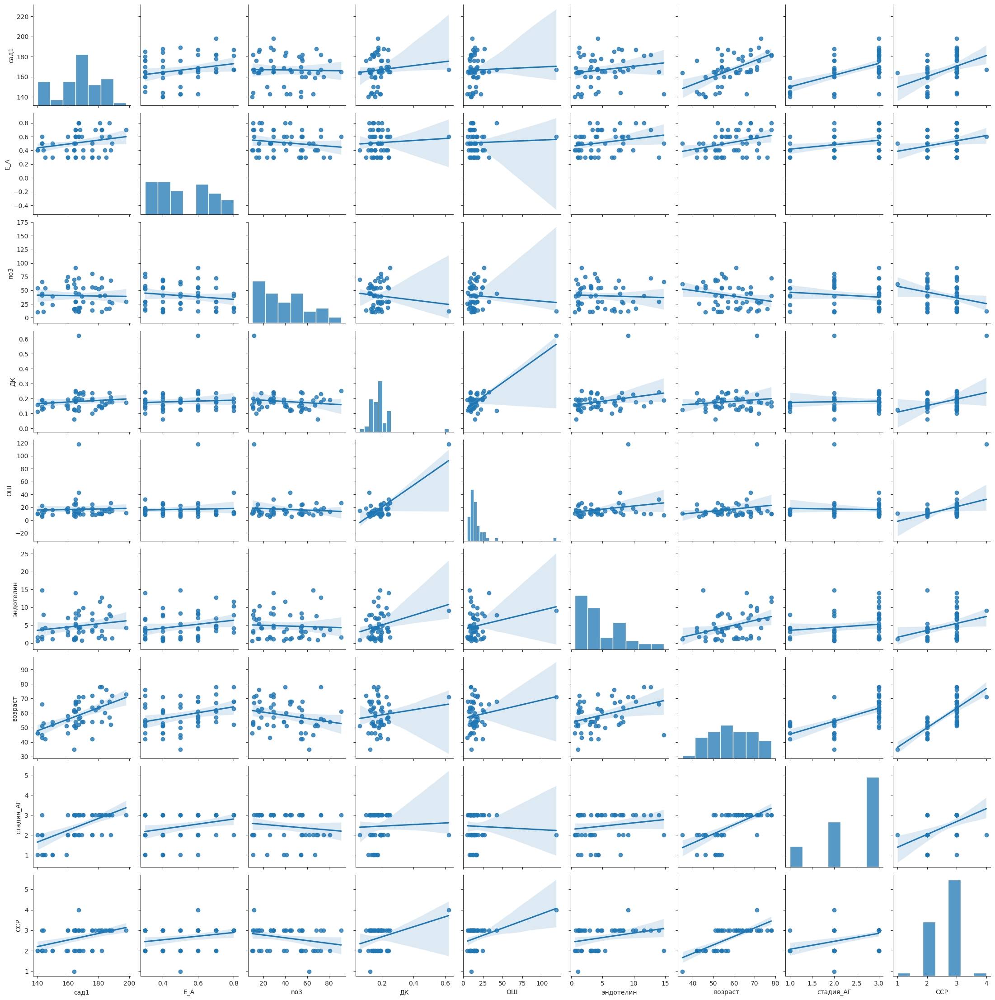

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'сад1',
'E_A',
'no3',
'ДК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

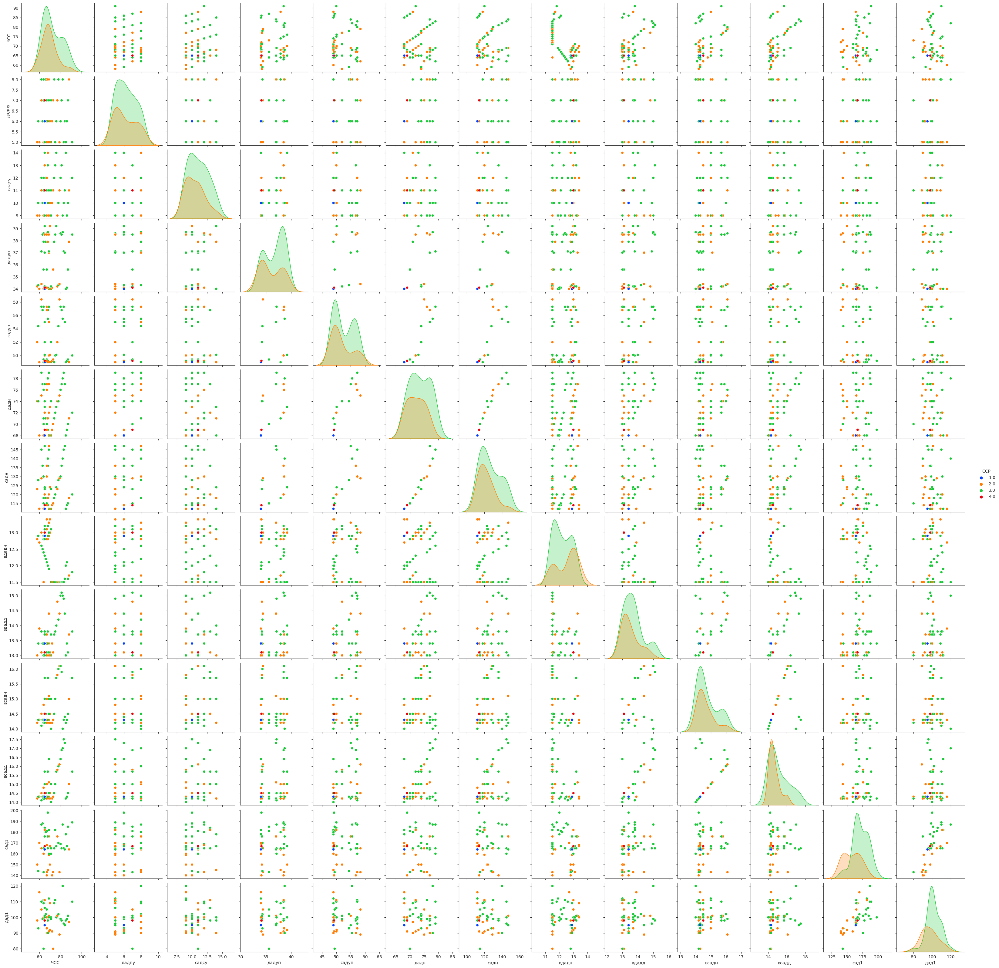

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

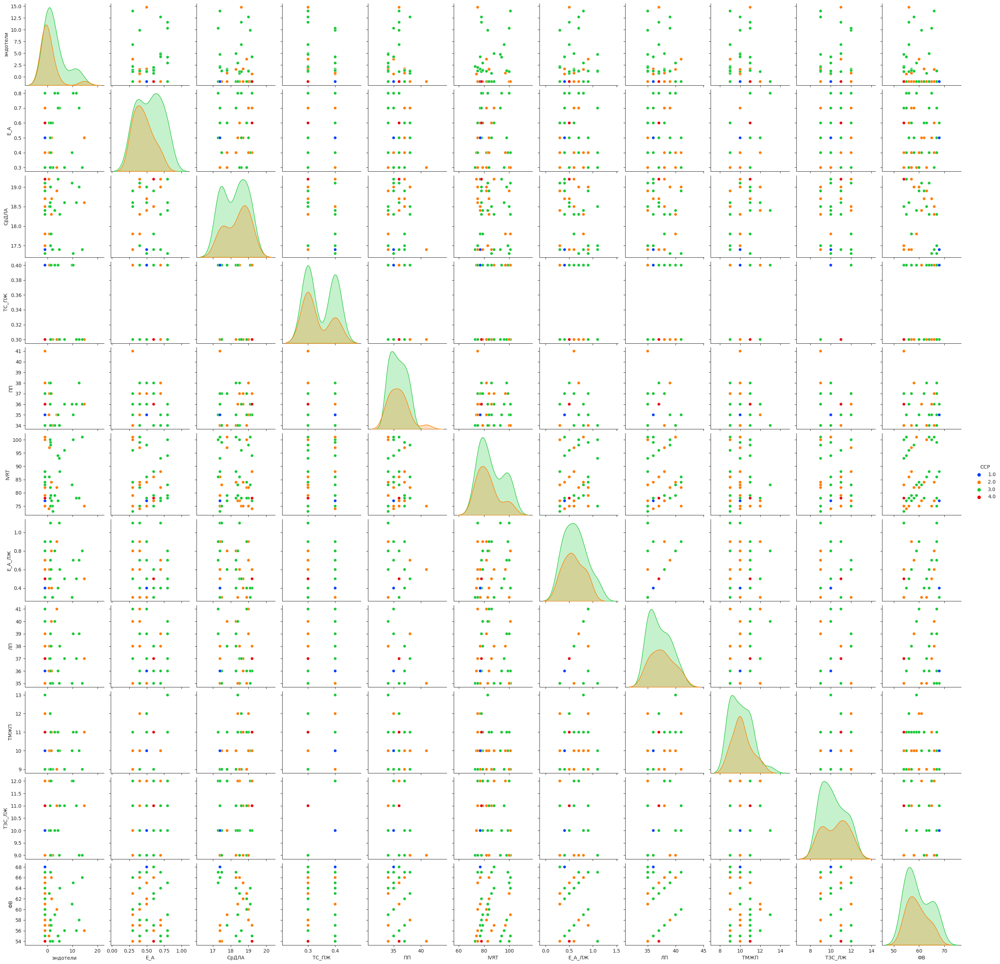

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

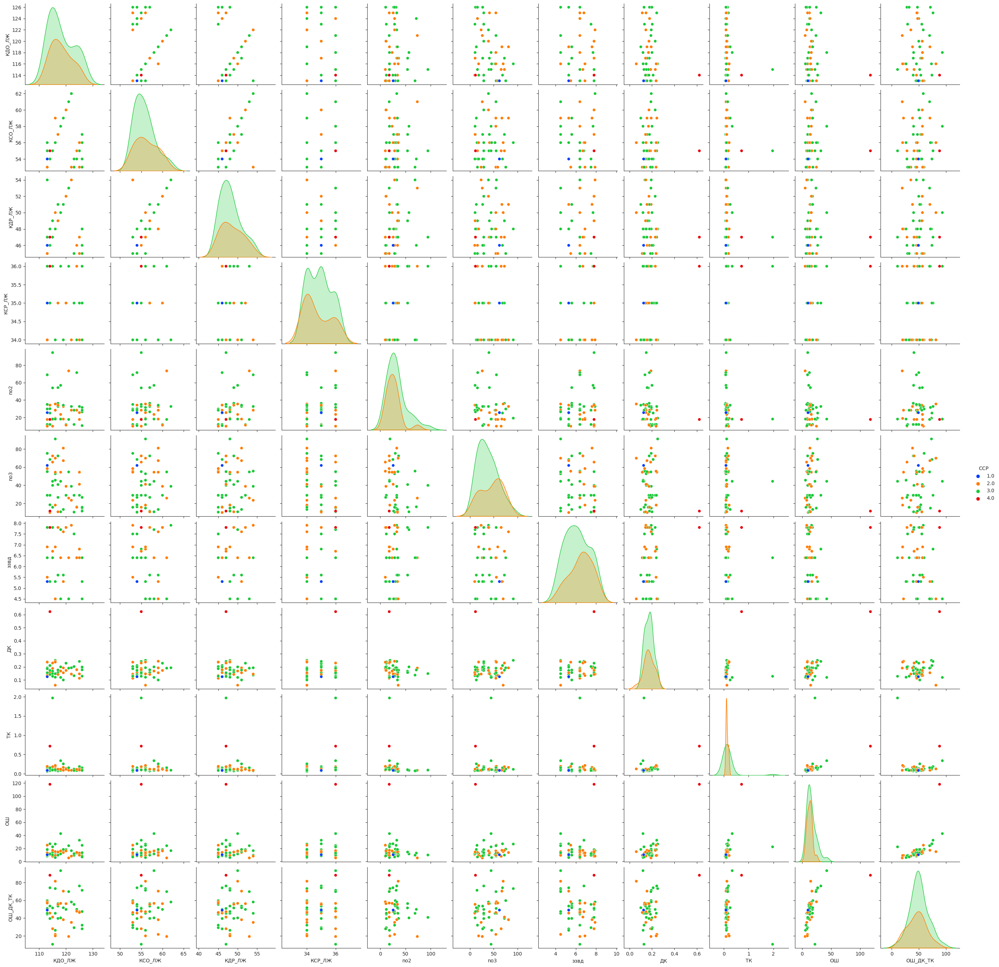

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

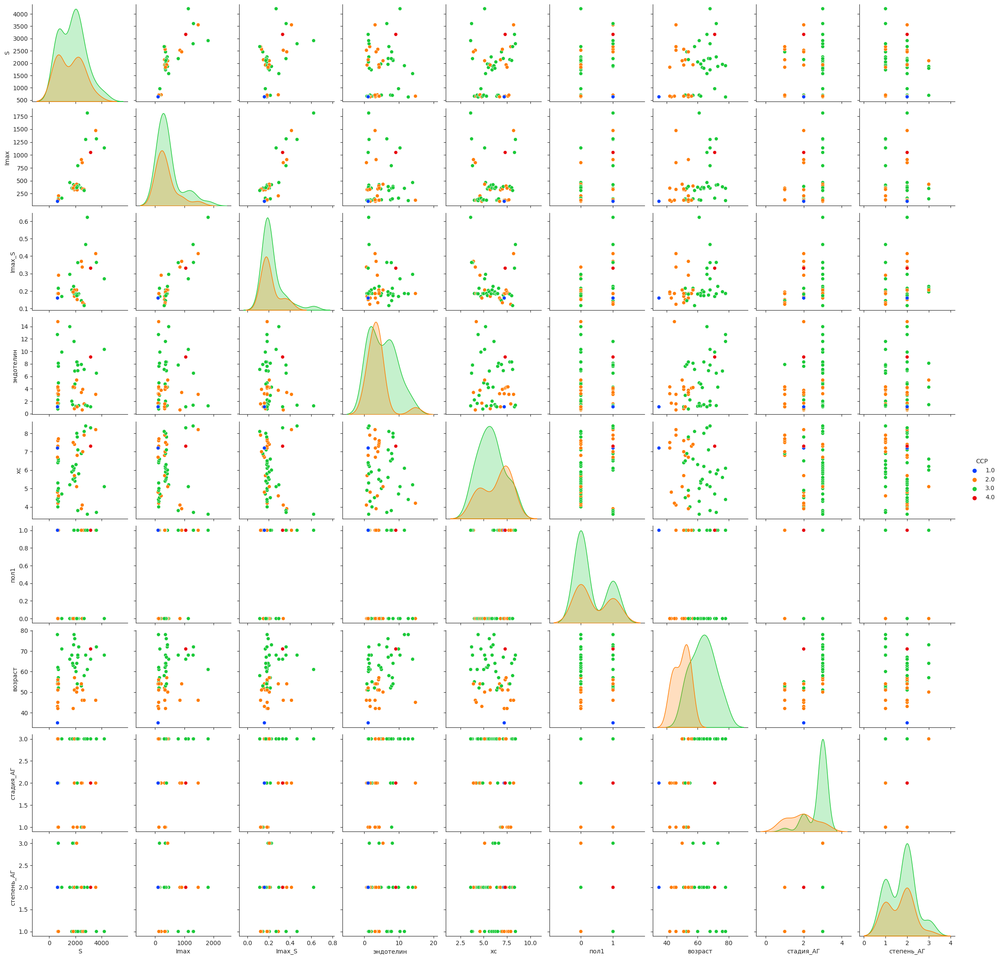

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

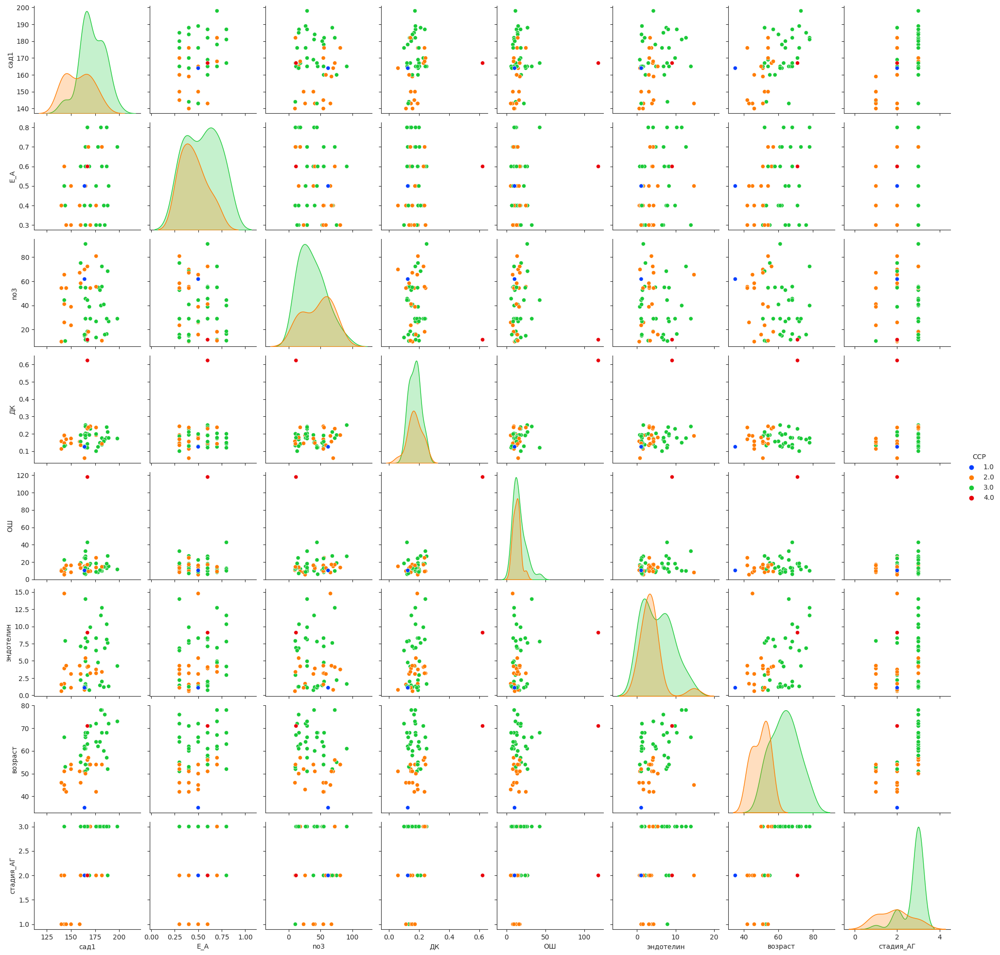

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1[[
'сад1',
'E_A',
'no3',
'ДК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

## Группа 2

In [ ]:
data_2 = pd.read_csv("ikm_start_2.csv")
data_2.head()

,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,вдадд,...,стп_ХОБЛ,офв1,эндотелин,хс,ик,пол1,возраст,стадия_АГ,степень_АГ,ССР
0,1.388,75,8,13,44.0,61.0,87,145,11.0,12.8,...,3,25,1.388,7.4,25,1,64,3,1,3
1,2.187,71,7,14,34.2,52.0,74,123,11.1,12.9,...,3,29,2.187,7.5,20,1,60,3,2,3
2,0.946,72,8,12,34.3,54.4,74,128,11.2,13.0,...,1,87,0.946,7.6,10,1,42,2,2,2
3,6.521,73,-1,12,38.6,57.3,76,130,11.3,13.1,...,3,34,6.521,7.7,20,1,82,3,1,3
4,3.229,74,7,15,38.5,56.8,77,136,11.4,13.2,...,2,59,3.229,7.8,23,1,65,3,1,3


In [ ]:
data_2.describe()

,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,вдадд,...,стп_ХОБЛ,офв1,эндотелин,хс,ик,пол1,возраст,стадия_АГ,степень_АГ,ССР
count,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,...,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000,67.000000
mean,2.389164,72.477612,7.044776,13.746269,38.871642,56.144776,81.880597,134.582090,12.685075,14.529851,...,2.253731,29.388060,9.956015,6.750746,10.462687,0.477612,55.194030,2.477612,1.925373,3.014925
std,6.335326,9.193803,1.753203,2.407962,3.516920,3.459256,7.576923,10.083213,0.635146,1.026322,...,0.804218,30.771374,5.062846,1.232068,10.586338,0.503268,10.554676,0.611957,0.559042,0.590134
min,-1.000000,57.000000,-1.000000,10.000000,34.100000,49.000000,69.000000,114.000000,11.000000,12.800000,...,1.000000,-1.000000,0.946000,3.700000,-1.000000,0.000000,40.000000,1.000000,1.000000,2.000000
25%,-1.000000,67.000000,6.000000,12.000000,35.650000,54.500000,76.000000,128.000000,12.650000,13.650000,...,2.000000,-1.000000,7.800000,5.850000,-1.000000,0.000000,42.500000,2.000000,2.000000,3.000000
50%,-1.000000,69.000000,7.000000,14.000000,38.600000,56.800000,80.000000,135.000000,12.800000,14.600000,...,2.000000,28.000000,8.996000,7.100000,12.000000,0.000000,57.000000,3.000000,2.000000,3.000000
75%,2.094000,78.500000,8.000000,15.500000,41.100000,57.300000,87.000000,144.500000,13.000000,15.400000,...,3.000000,49.000000,11.546000,7.700000,20.000000,1.000000,62.500000,3.000000,2.000000,3.000000
max,25.000000,91.000000,10.000000,18.000000,45.700000,64.400000,99.000000,152.000000,13.900000,16.200000,...,3.000000,88.000000,25.000000,8.400000,30.000000,1.000000,82.000000,3.000000,3.000000,4.000000


In [ ]:
data_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 49 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   эндотели    67 non-null     float64
 1   ЧСС         67 non-null     int64  
 2   дадпу       67 non-null     int64  
 3   садсу       67 non-null     int64  
 4   дадуп       67 non-null     float64
 5   садуп       67 non-null     float64
 6   дадн        67 non-null     int64  
 7   садн        67 non-null     int64  
 8   вдадн       67 non-null     float64
 9   вдадд       67 non-null     float64
 10  всадн       67 non-null     float64
 11  всадд       67 non-null     float64
 12  сад1        67 non-null     int64  
 13  дад1        67 non-null     int64  
 14  E_A         67 non-null     float64
 15  СрДЛА       67 non-null     float64
 16  ТС_ПЖ       67 non-null     float64
 17  ПП          67 non-null     int64  
 18  IVRT        67 non-null     int64  
 19  E_A_ЛЖ      67 non-null     flo

<Axes: >

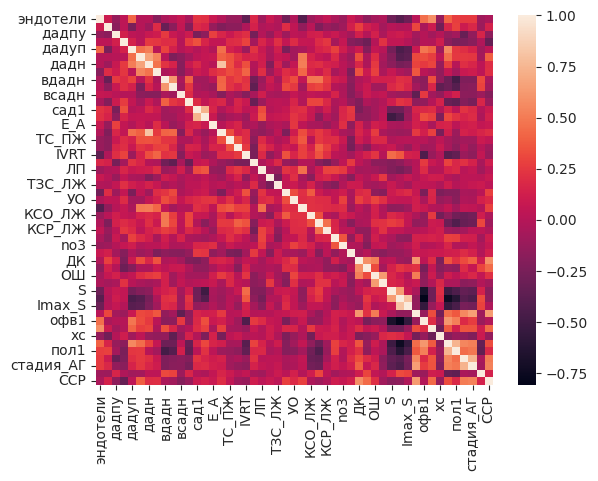

In [ ]:
sns.heatmap(data_2.corr(), annot=False)

<Axes: >

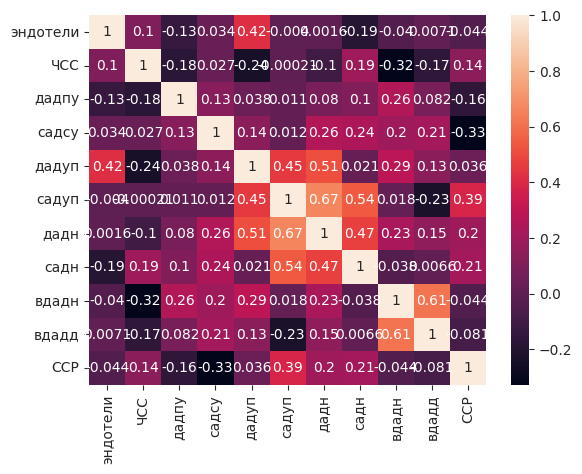

In [ ]:
sns.heatmap(data_2[[
'эндотели',
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

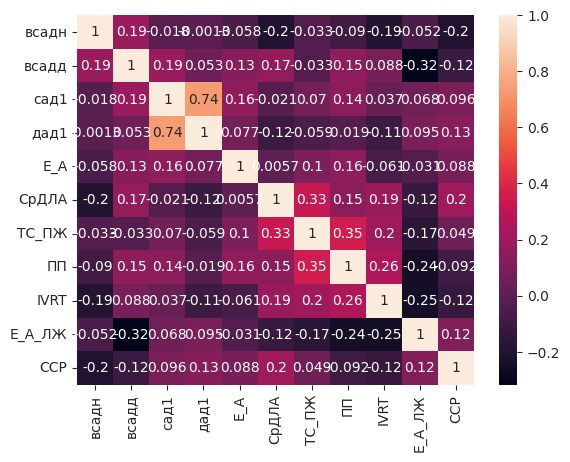

In [ ]:
sns.heatmap(data_2[[
'всадн',
'всадд',
'сад1',
'дад1',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

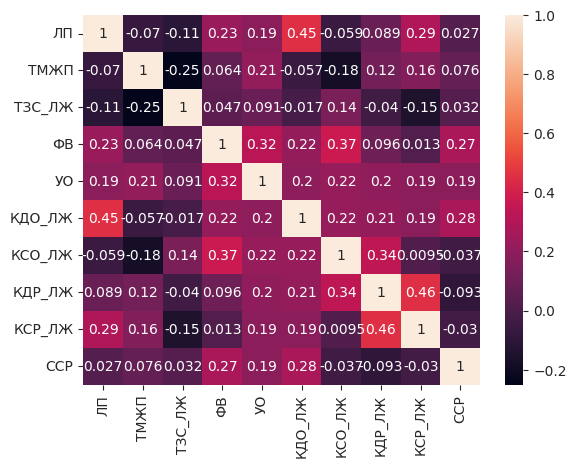

In [ ]:
sns.heatmap(data_2[[
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',
'УО',
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

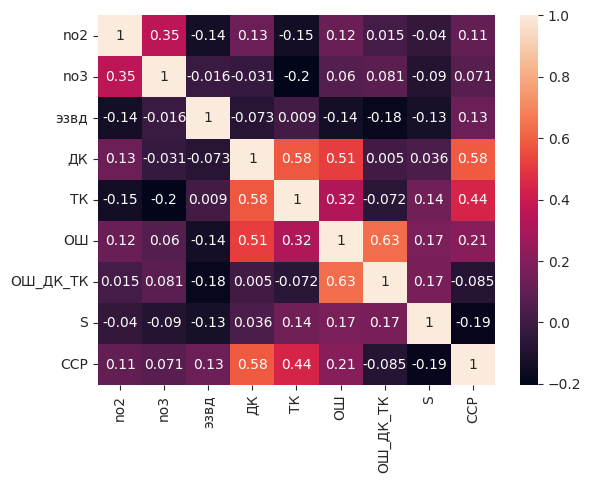

In [ ]:
sns.heatmap(data_2[[
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',
'S',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

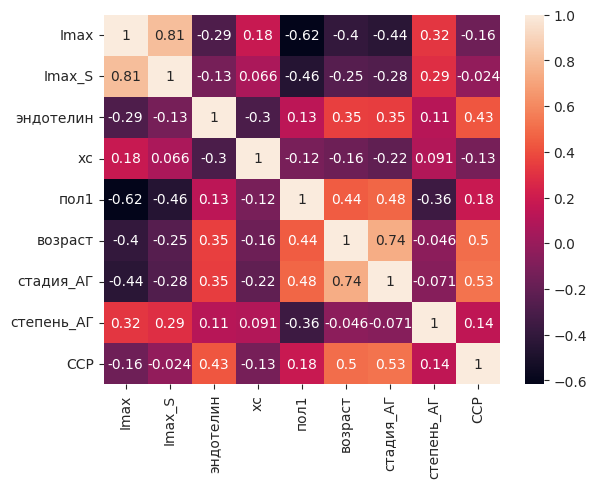

In [ ]:
sns.heatmap(data_2[[
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

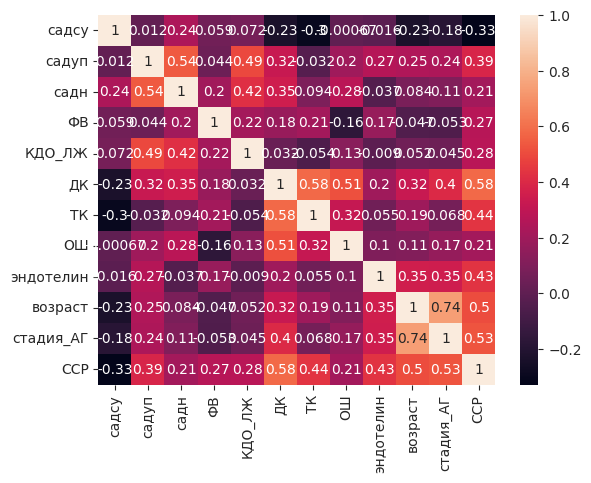

In [ ]:
sns.heatmap(data_2[[
'садсу',
'садуп',
'садн',
'ФВ',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]].corr(), annot=True)

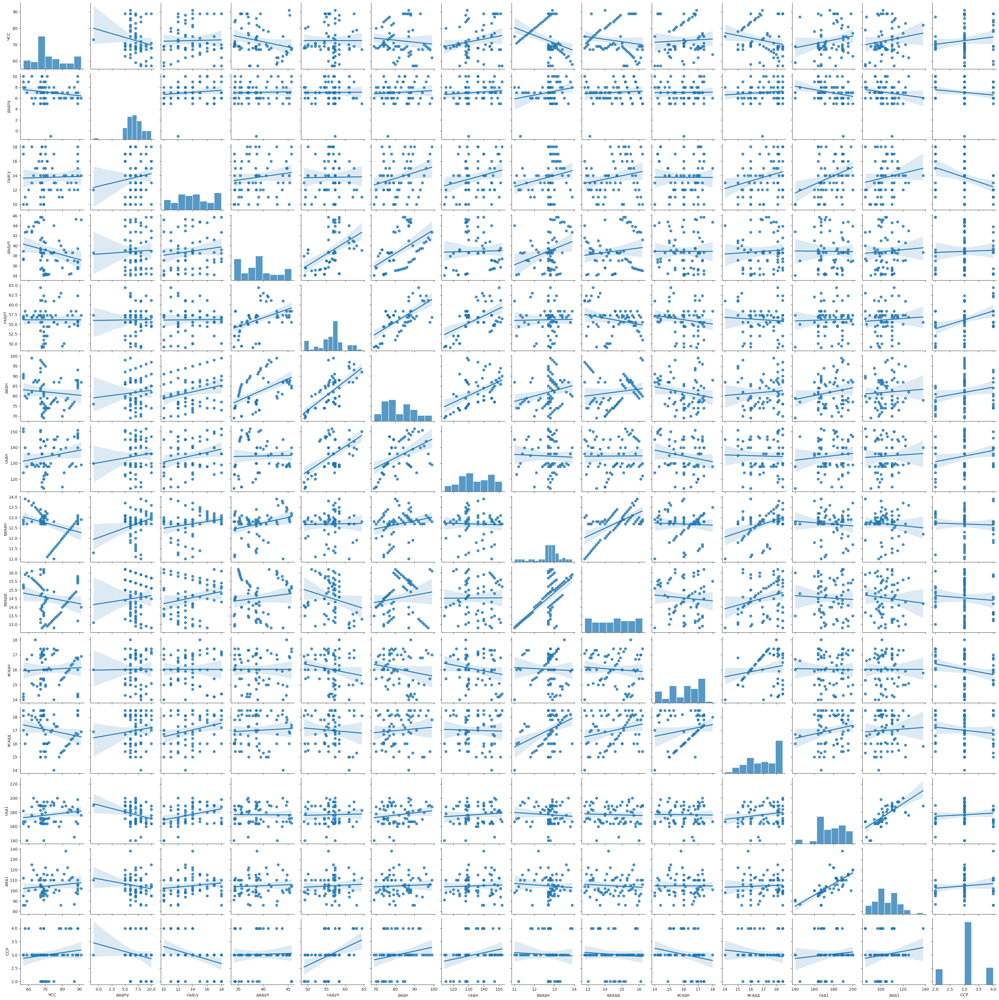

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                    ]], kind="reg")
plt.show()

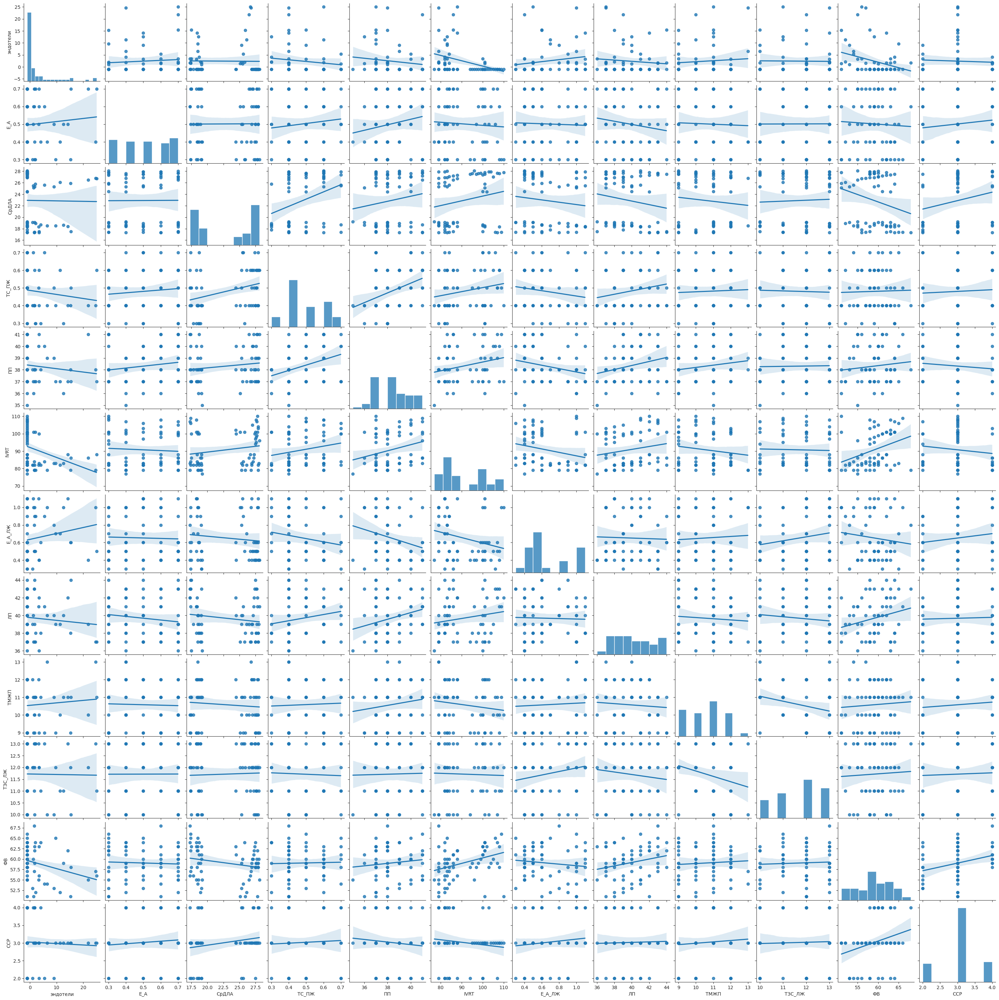

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                    ]], kind="reg")
plt.show()

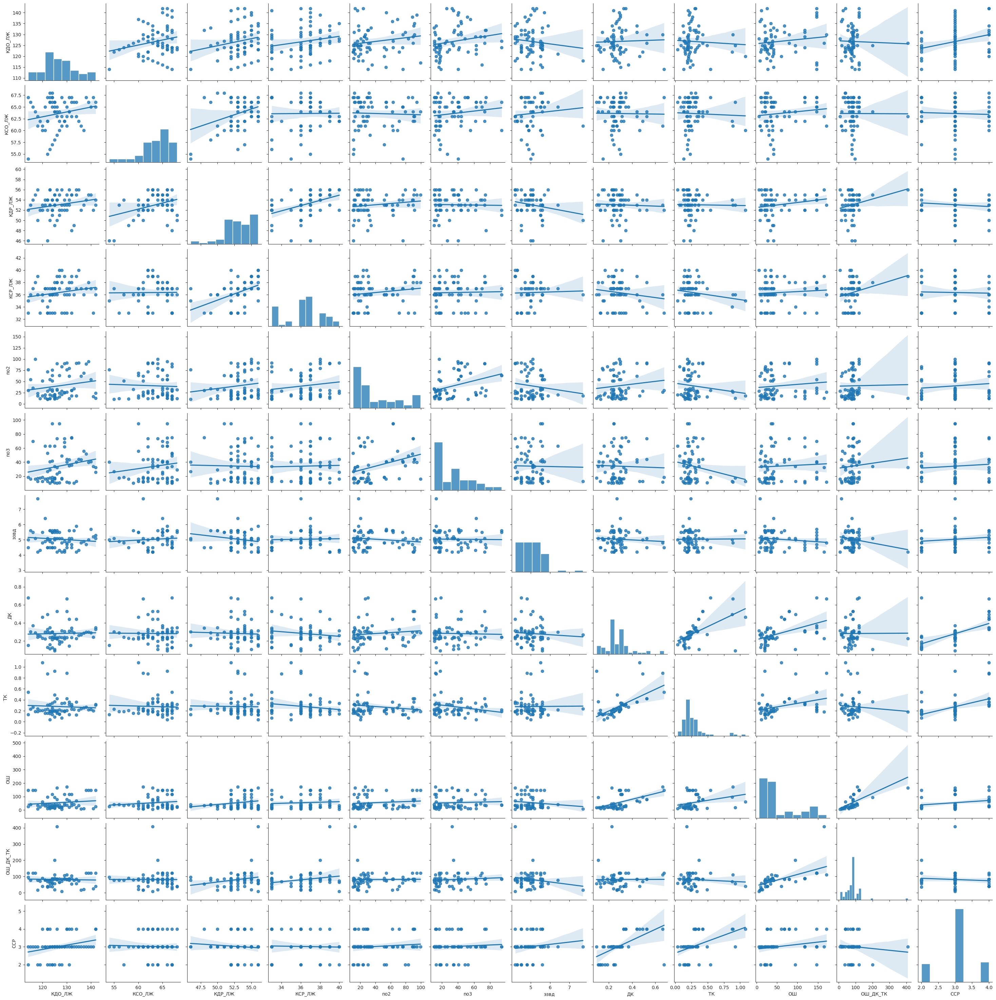

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                    ]], kind="reg")
plt.show()

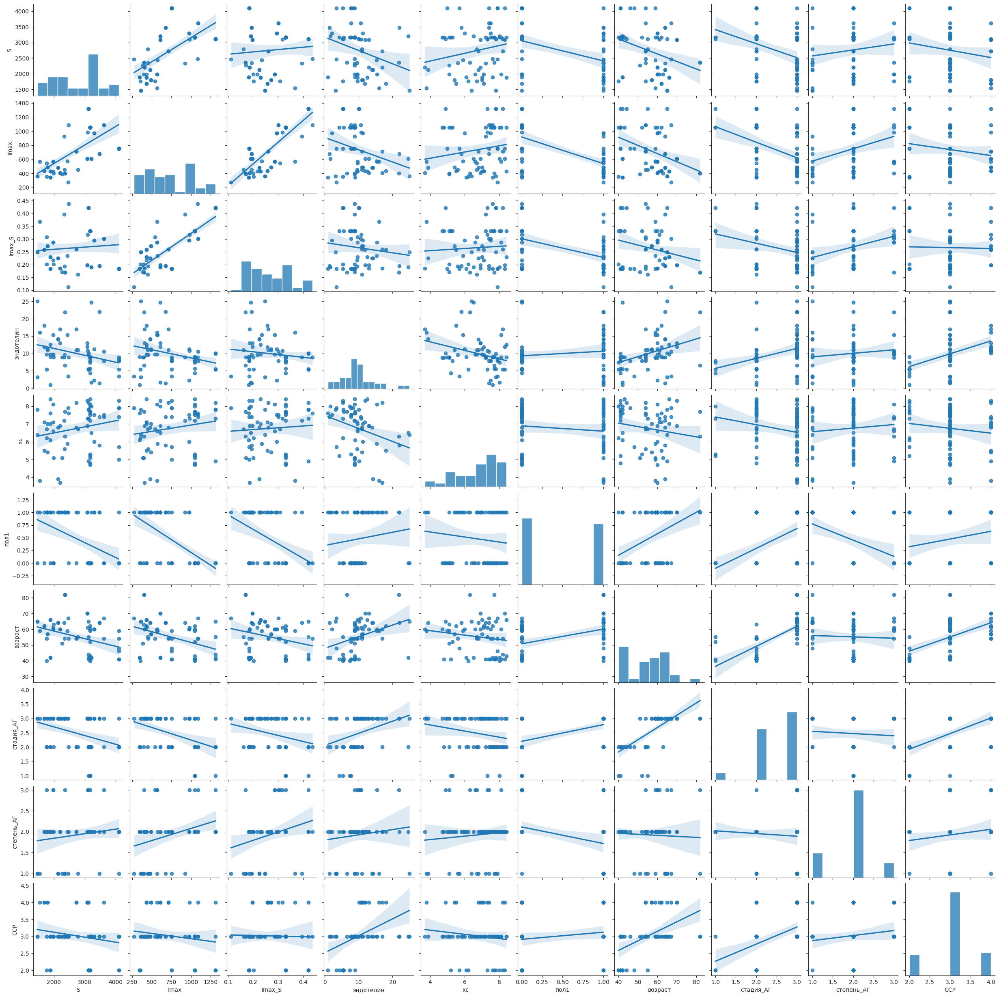

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

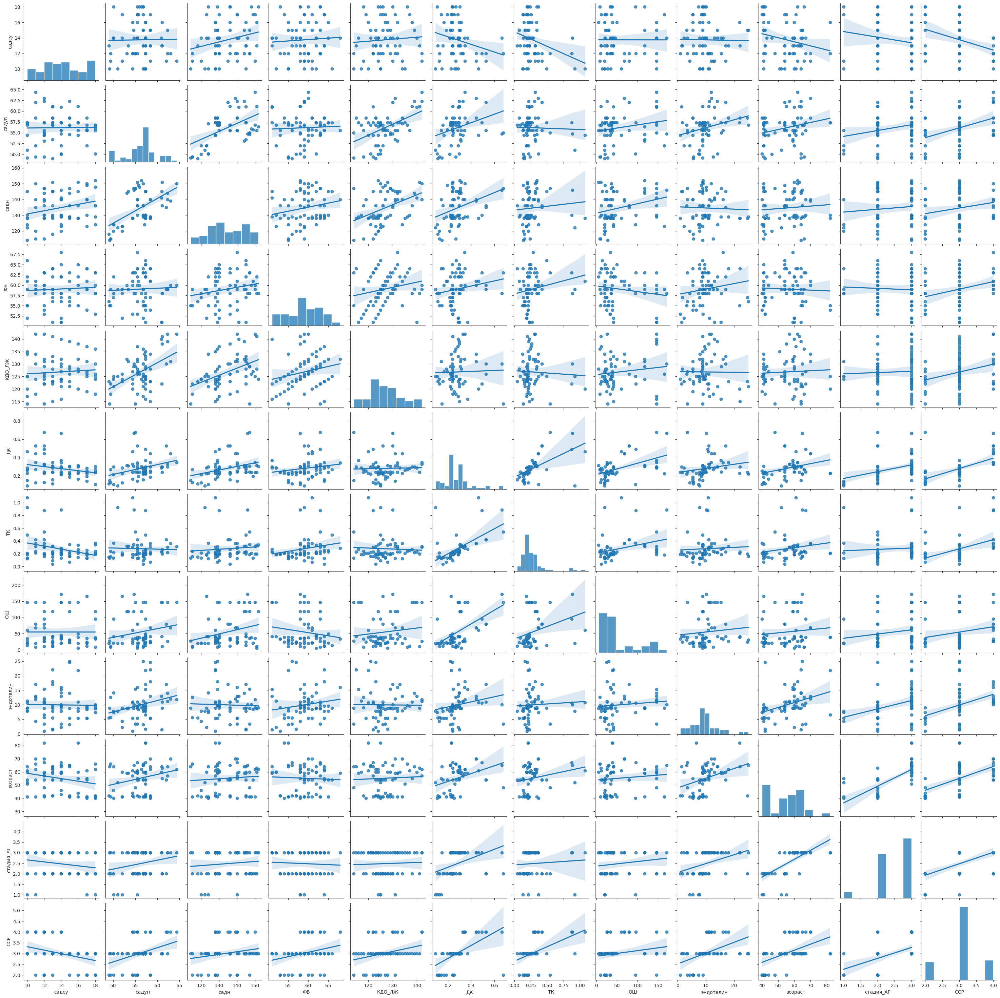

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'садсу',
'садуп',
'садн',
'ФВ',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

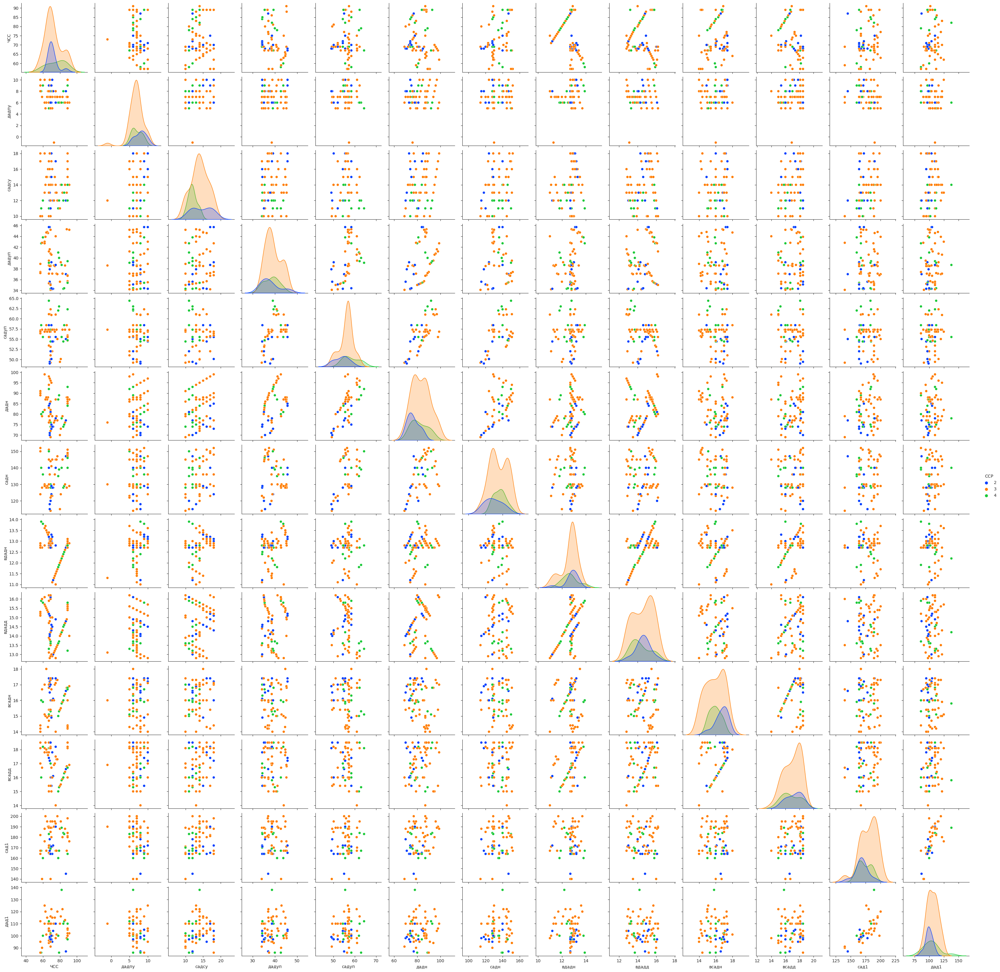

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

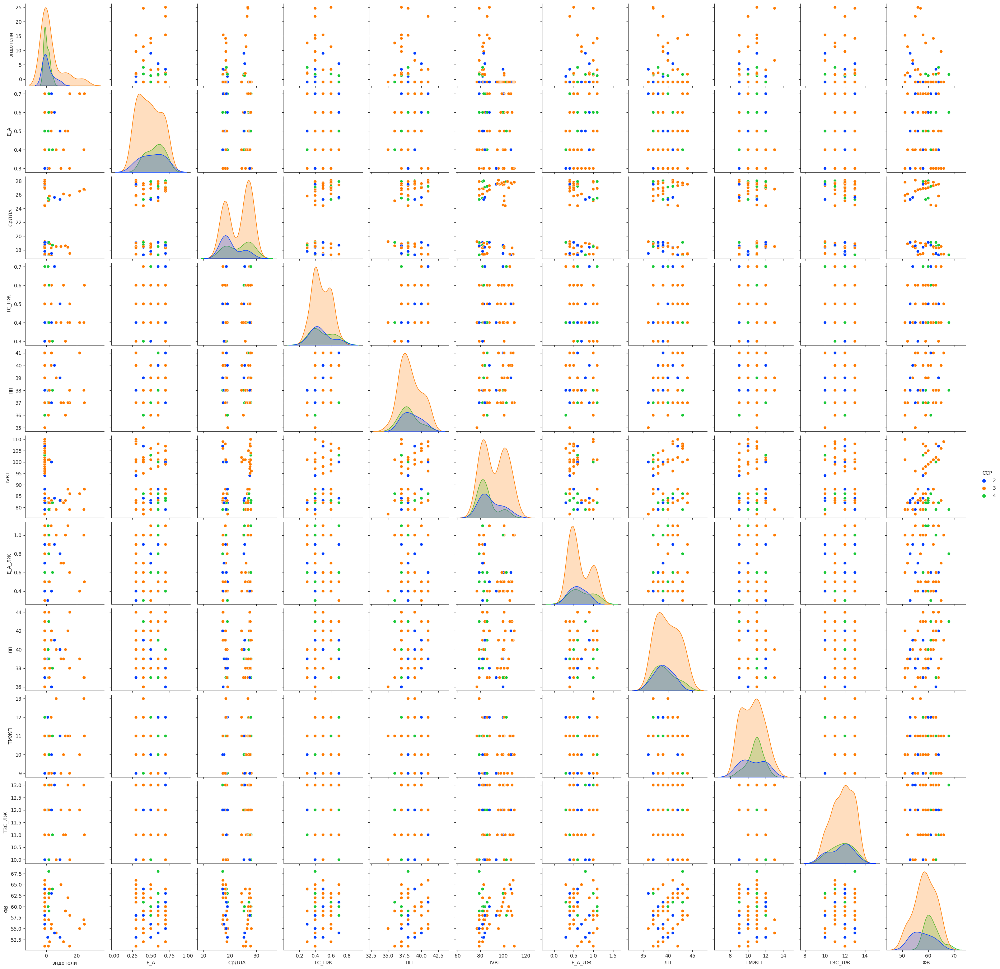

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

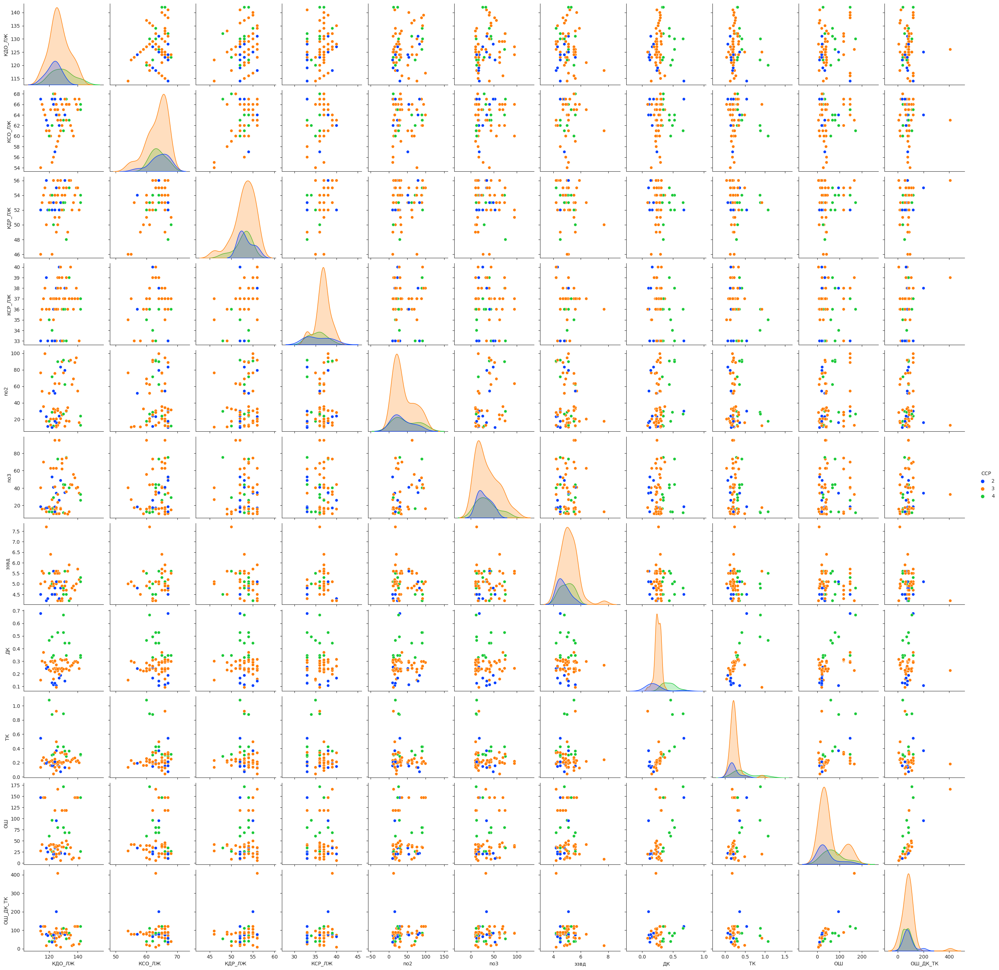

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

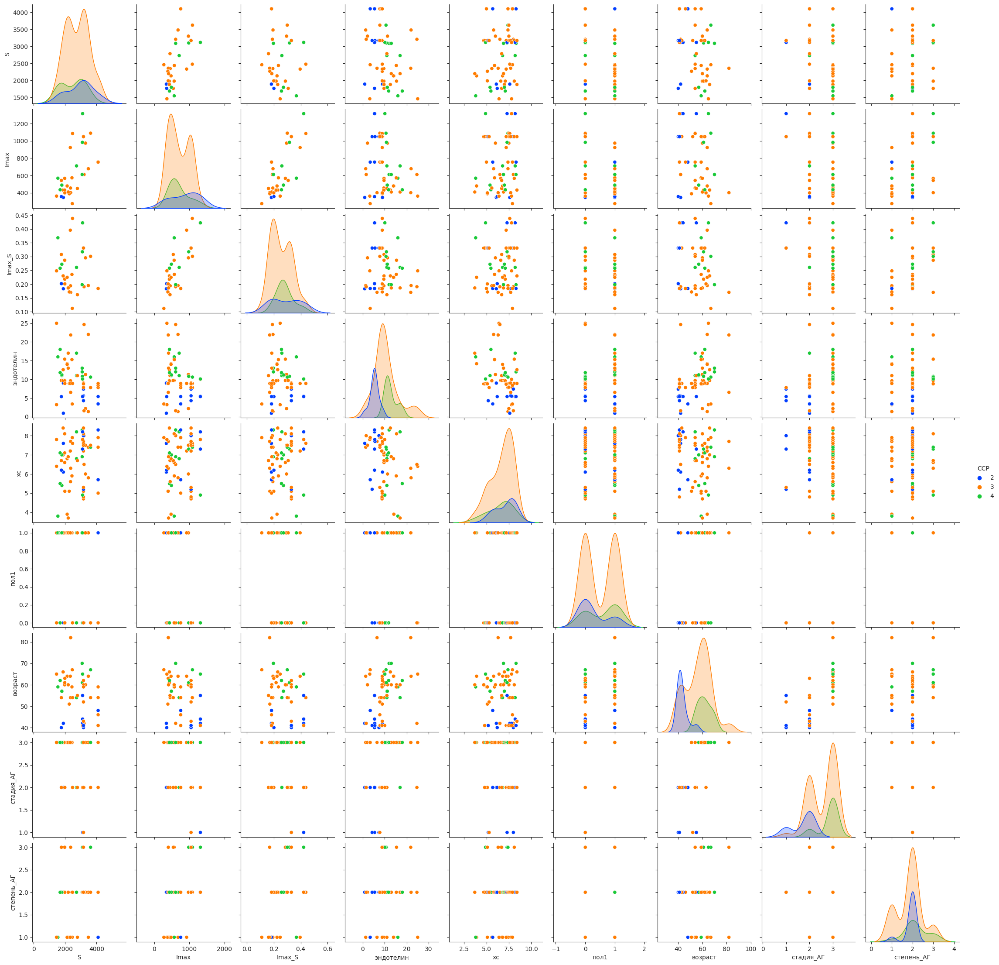

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

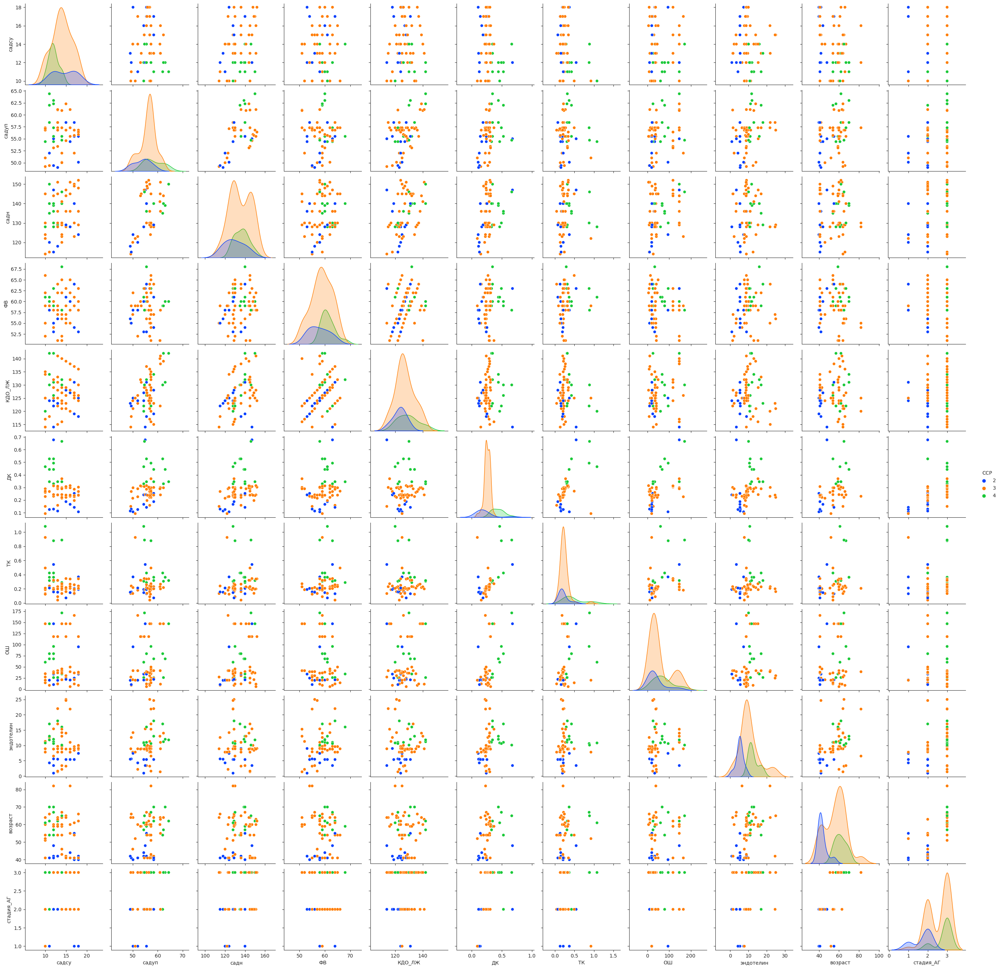

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_2[[
'садсу',
'садуп',
'садн',
'ФВ',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

## Группы 1-2

In [ ]:
data_1_2 = pd.read_csv("ikm_start_1-2.csv")
data_1_2.head()

,группа,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,...,стп_ХОБЛ,офв1,эндотелин,хс,ик,пол1,возраст,стадия_АГ,степень_АГ,ССР
0,1,2.207,71,5,9,34.0,49.0,68,112,11.5,...,-1,-1,2.207,4.0,-1,0,55,2,2,3
1,1,0.600,72,6,10,34.1,49.2,69,114,11.5,...,-1,-1,0.600,4.1,-1,0,46,2,2,2
2,1,14.775,73,7,11,35.6,49.4,70,115,11.5,...,-1,-1,14.775,4.2,-1,0,45,2,2,2
3,1,1.647,74,8,12,37.9,49.0,71,118,11.5,...,-1,-1,1.647,4.3,-1,0,61,3,2,3
4,1,12.706,75,5,13,38.5,50.0,72,120,11.5,...,-1,-1,12.706,4.4,-1,0,78,3,2,3


In [ ]:
data_1_2.describe()

,группа,эндотели,ЧСС,дадпу,садсу,дадуп,садуп,дадн,садн,вдадн,...,стп_ХОБЛ,офв1,эндотелин,хс,ик,пол1,возраст,стадия_АГ,степень_АГ,ССР
count,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,...,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000,119.000000
mean,1.563025,2.211916,71.815126,6.697479,12.478992,37.803361,54.405042,77.941176,130.159664,12.535294,...,0.831933,16.109244,7.690731,6.436134,5.453782,0.428571,56.579832,2.462185,1.840336,2.848739
std,0.498109,5.499542,8.773000,1.559849,2.534002,3.187500,3.973617,7.588231,11.637886,0.674674,...,1.728717,27.544968,5.181481,1.356886,9.761345,0.496964,10.439085,0.661148,0.581978,0.605605
min,1.000000,-1.000000,57.000000,-1.000000,9.000000,34.000000,49.000000,68.000000,112.000000,11.000000,...,-1.000000,-1.000000,0.600000,3.600000,-1.000000,0.000000,35.000000,1.000000,1.000000,1.000000
25%,1.000000,-1.000000,66.500000,6.000000,10.000000,35.050000,50.000000,72.000000,120.000000,12.000000,...,-1.000000,-1.000000,3.420000,5.300000,-1.000000,0.000000,50.500000,2.000000,1.000000,2.500000
50%,2.000000,-1.000000,69.000000,7.000000,12.000000,37.900000,55.500000,77.000000,129.000000,12.800000,...,1.000000,-1.000000,7.800000,6.700000,-1.000000,0.000000,57.000000,3.000000,2.000000,3.000000
75%,2.000000,2.197000,77.500000,8.000000,14.000000,38.800000,57.300000,82.000000,140.000000,13.000000,...,3.000000,30.000000,10.050000,7.600000,14.000000,1.000000,64.000000,3.000000,2.000000,3.000000
max,2.000000,25.000000,91.000000,10.000000,18.000000,45.700000,64.400000,99.000000,152.000000,13.900000,...,3.000000,88.000000,25.000000,8.400000,30.000000,1.000000,82.000000,3.000000,3.000000,4.000000


In [ ]:
data_1_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119 entries, 0 to 118
Data columns (total 50 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   группа      119 non-null    int64  
 1   эндотели    119 non-null    float64
 2   ЧСС         119 non-null    int64  
 3   дадпу       119 non-null    int64  
 4   садсу       119 non-null    int64  
 5   дадуп       119 non-null    float64
 6   садуп       119 non-null    float64
 7   дадн        119 non-null    int64  
 8   садн        119 non-null    int64  
 9   вдадн       119 non-null    float64
 10  вдадд       119 non-null    float64
 11  всадн       119 non-null    float64
 12  всадд       119 non-null    float64
 13  сад1        119 non-null    int64  
 14  дад1        119 non-null    int64  
 15  E_A         119 non-null    float64
 16  СрДЛА       119 non-null    float64
 17  ТС_ПЖ       119 non-null    float64
 18  ПП          119 non-null    int64  
 19  IVRT        119 non-null    i

<Axes: >

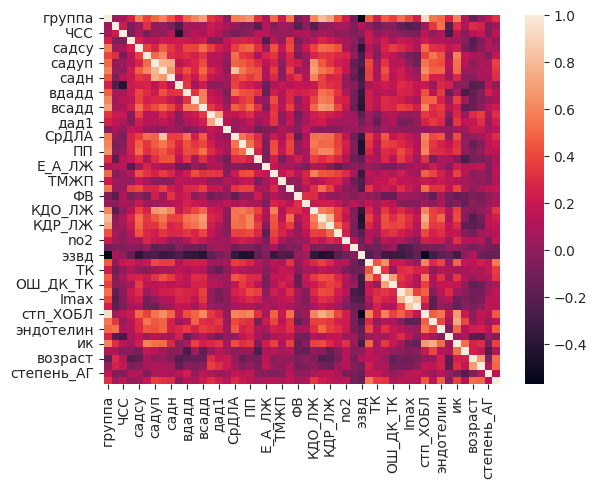

In [ ]:
sns.heatmap(data_1_2.corr(), annot=False)

<Axes: >

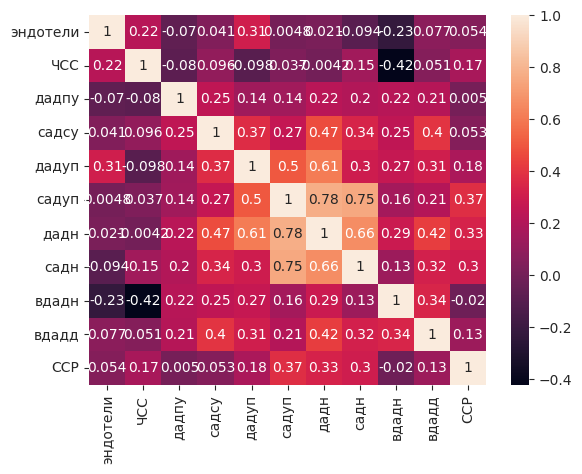

In [ ]:
sns.heatmap(data_1_2[[
'эндотели',
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

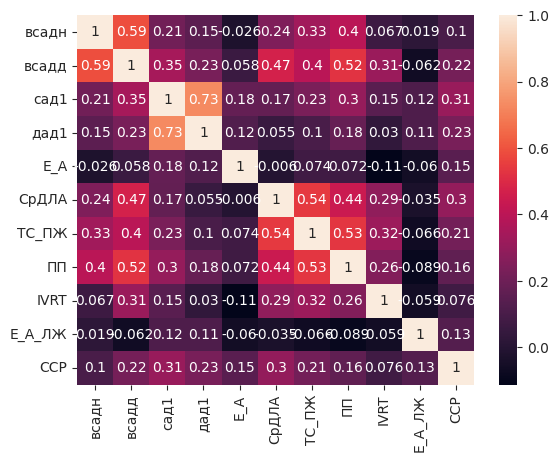

In [ ]:
sns.heatmap(data_1_2[[
'всадн',
'всадд',
'сад1',
'дад1',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

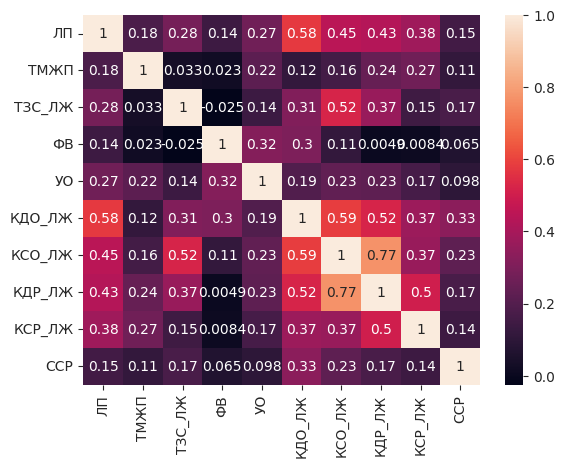

In [ ]:
sns.heatmap(data_1_2[[
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',
'УО',
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

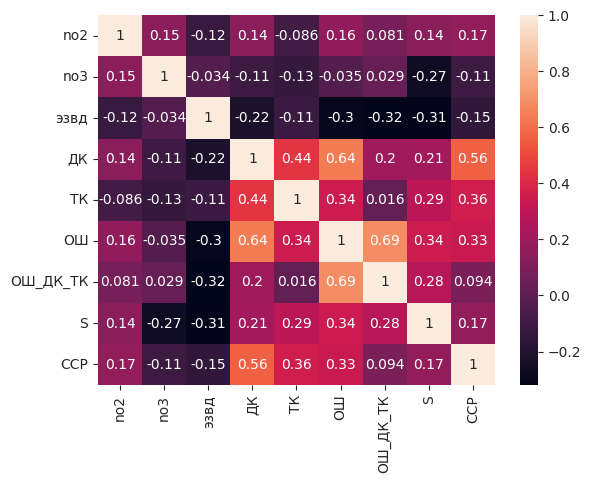

In [ ]:
sns.heatmap(data_1_2[[
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',
'S',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

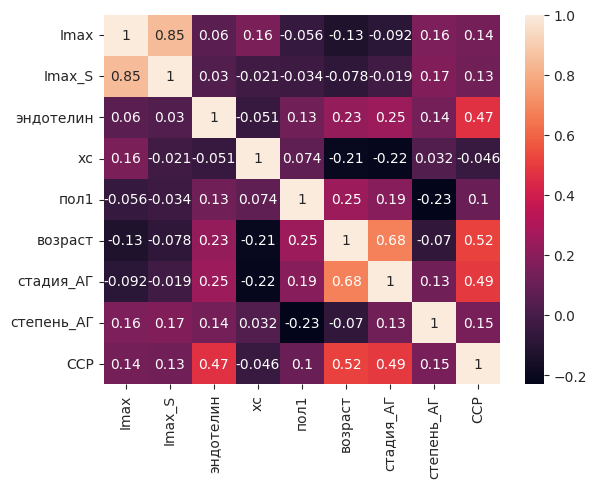

In [ ]:
sns.heatmap(data_1_2[[
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

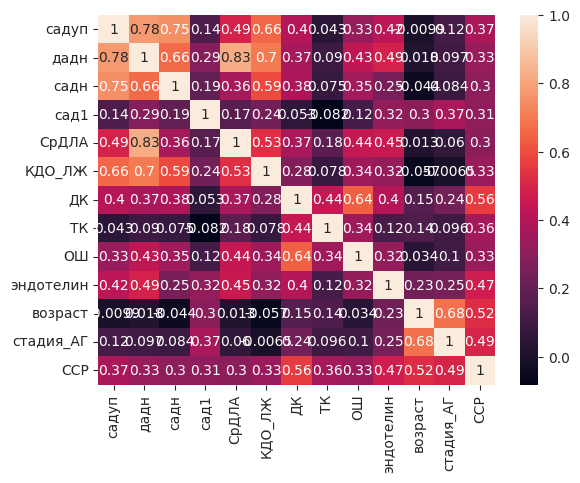

In [ ]:
sns.heatmap(data_1_2[[
'садуп',
'дадн',
'садн',
'сад1',
'СрДЛА',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

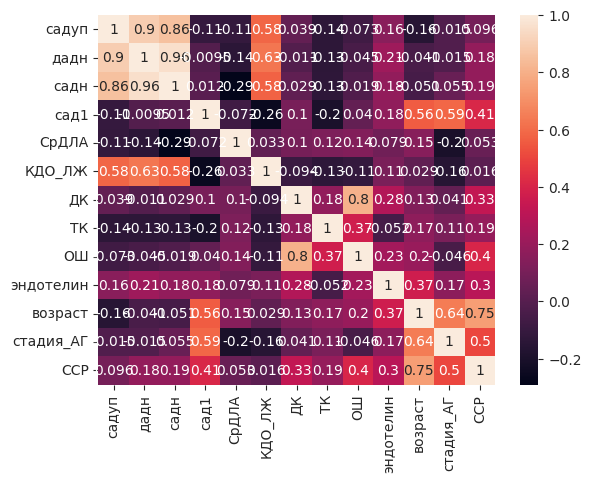

In [ ]:
sns.heatmap(data_1[[
'садуп',
'дадн',
'садн',
'сад1',
'СрДЛА',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]].corr(), annot=True)

<Axes: >

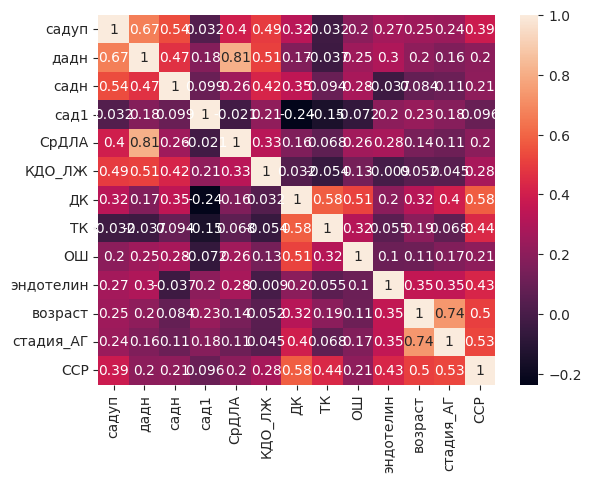

In [ ]:
sns.heatmap(data_2[[
'садуп',
'дадн',
'садн',
'сад1',
'СрДЛА',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]].corr(), annot=True)

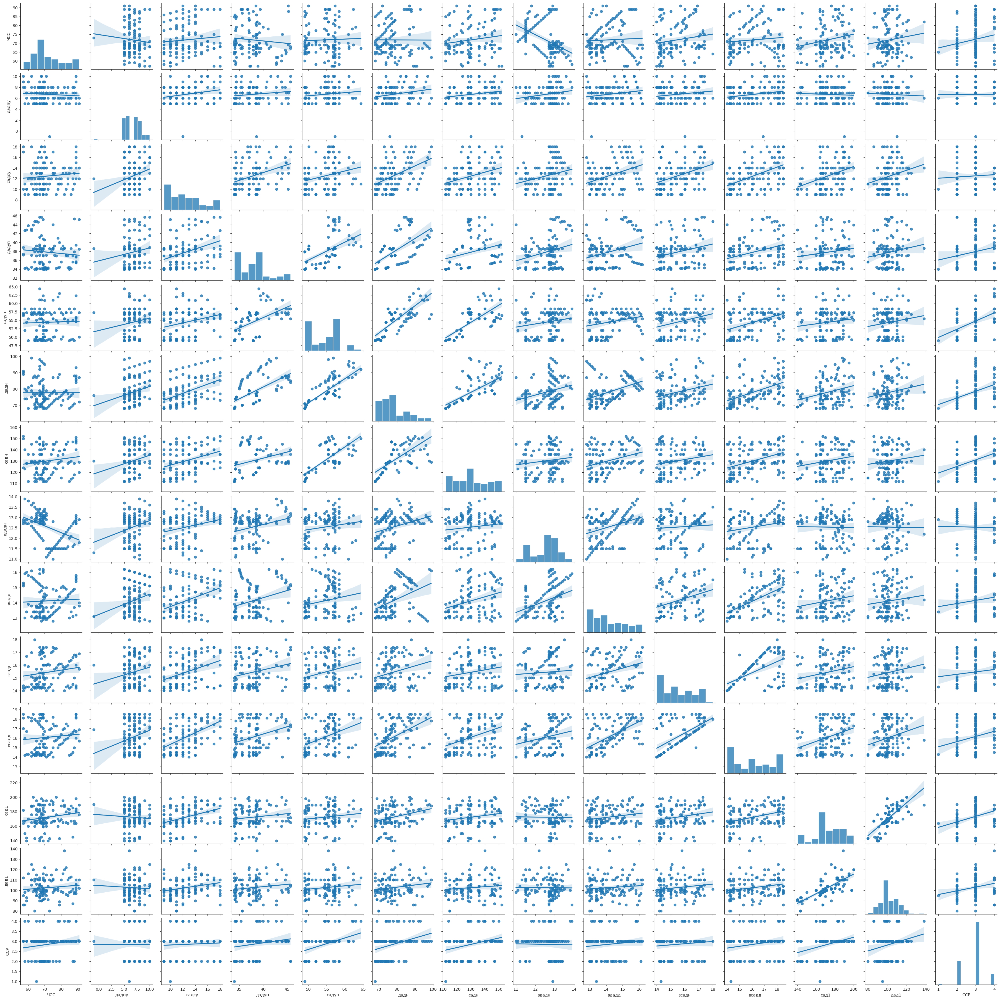

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                    ]], kind="reg")
plt.show()

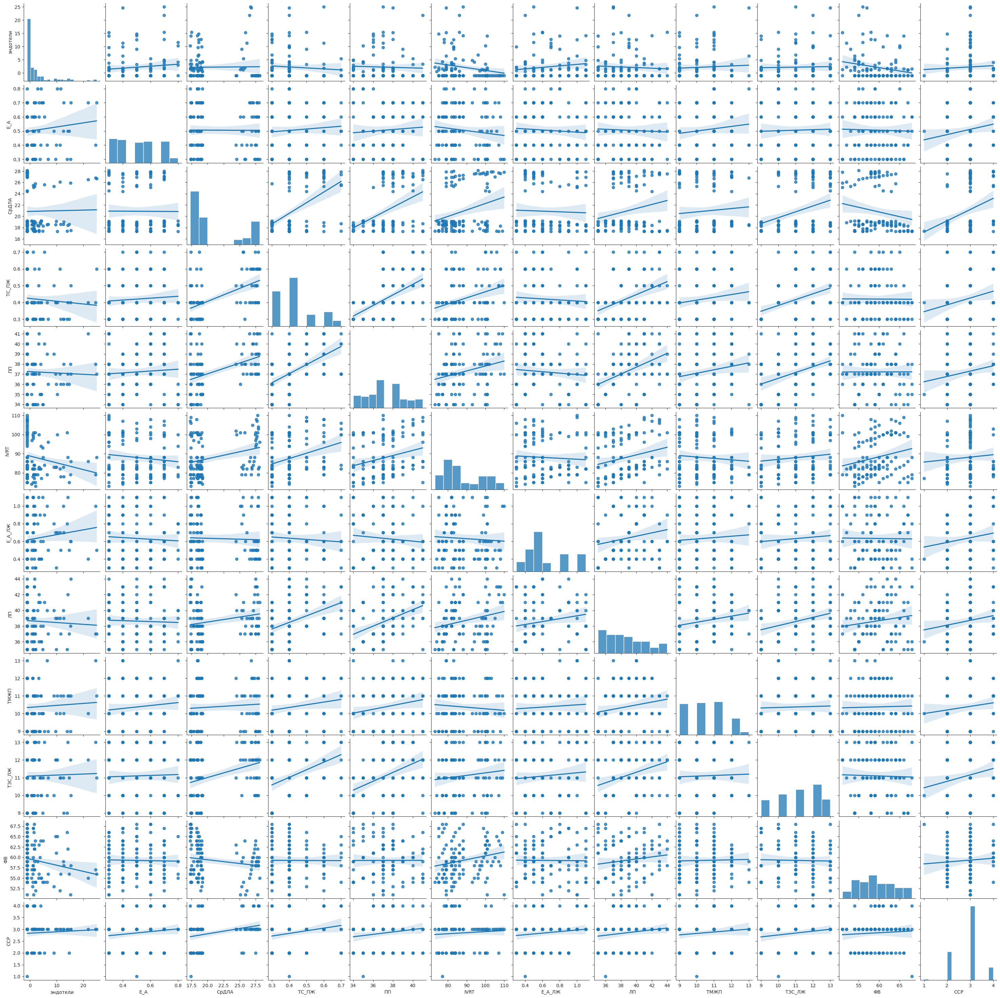

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                    ]], kind="reg")
plt.show()

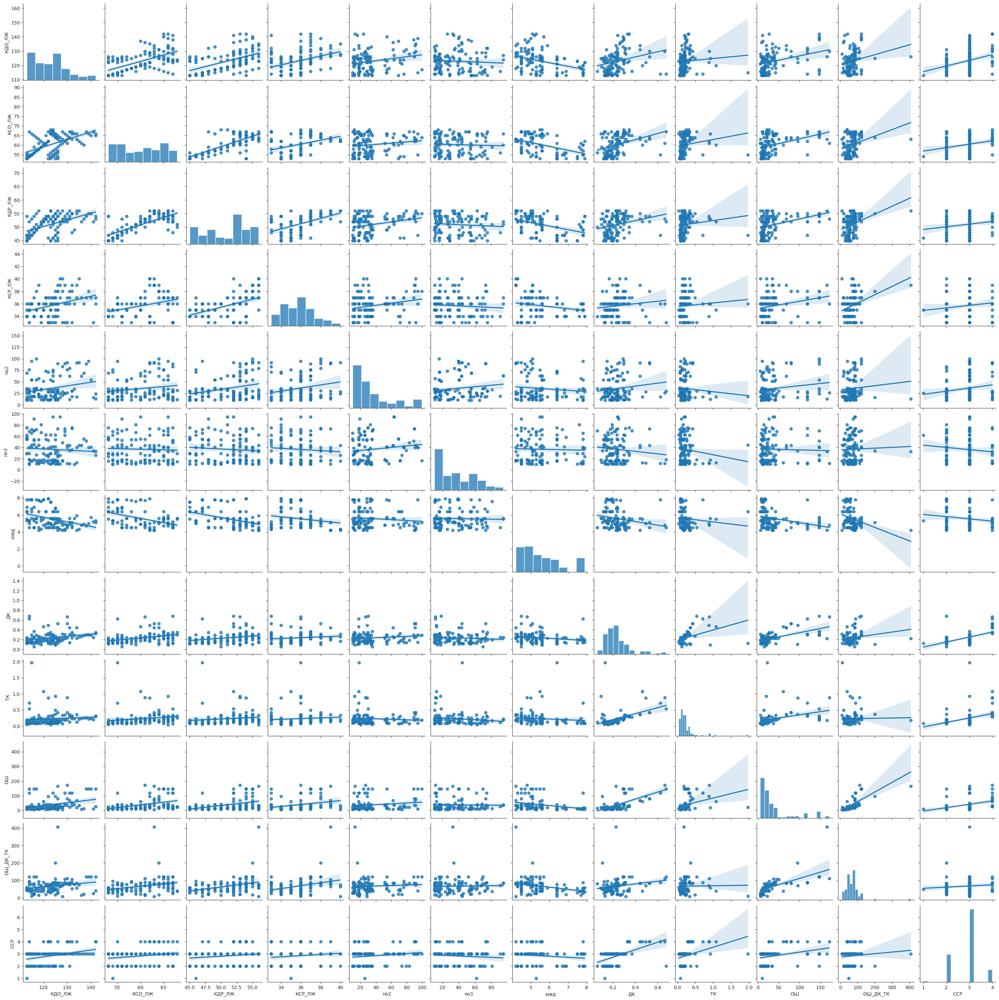

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                    ]], kind="reg")
plt.show()

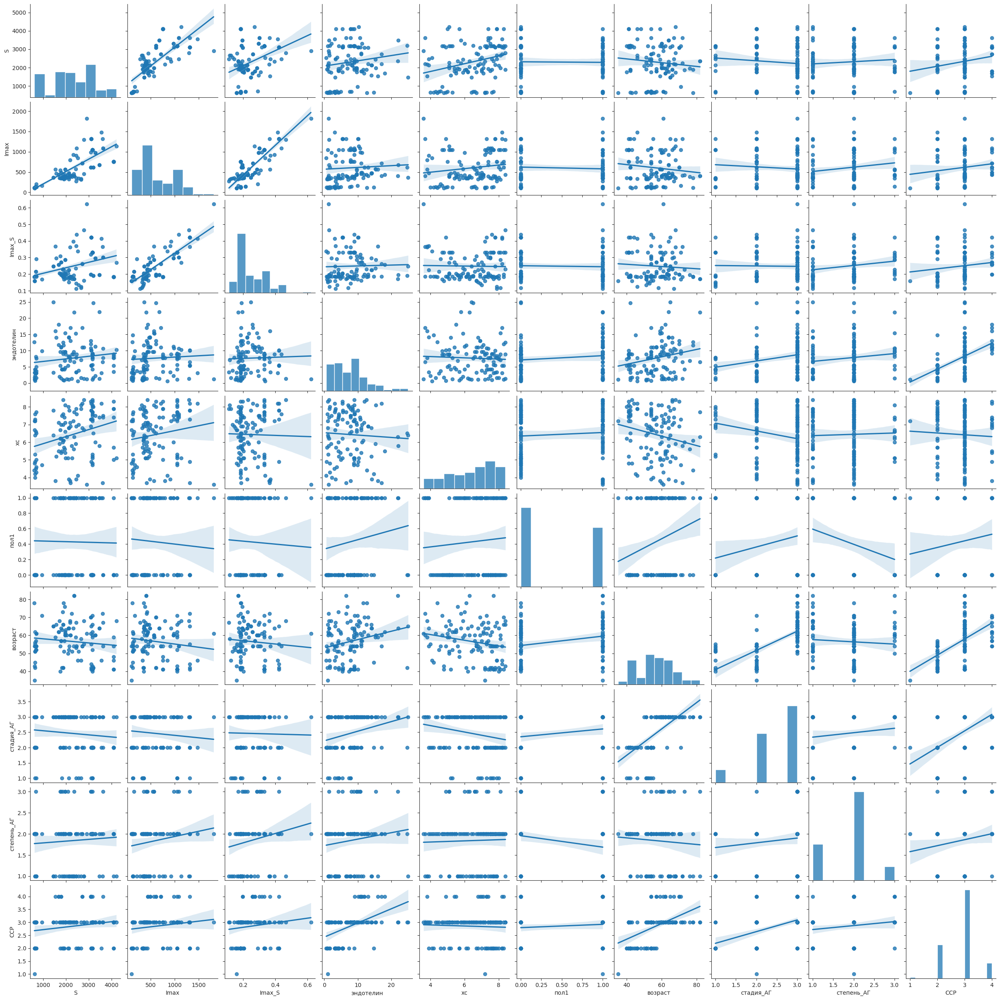

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

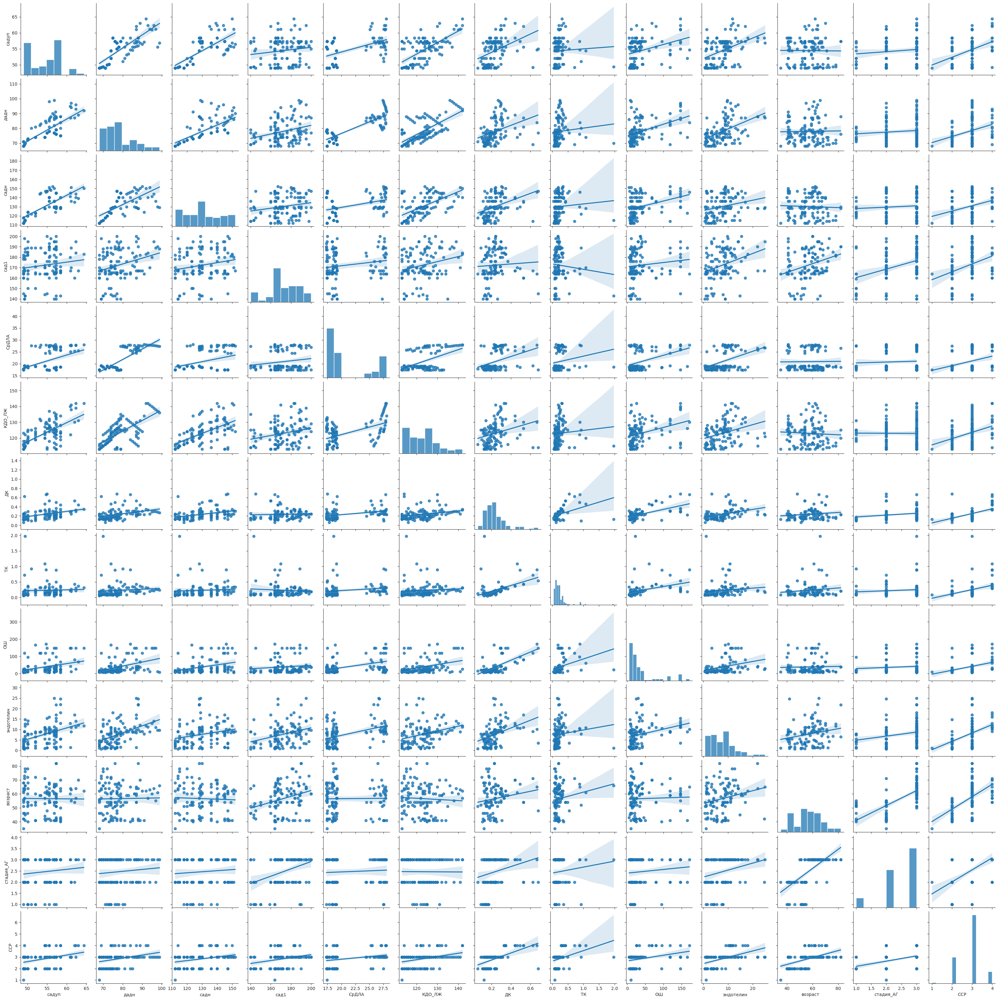

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'садуп',
'дадн',
'садн',
'сад1',
'СрДЛА',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                    ]], kind="reg")
plt.show()

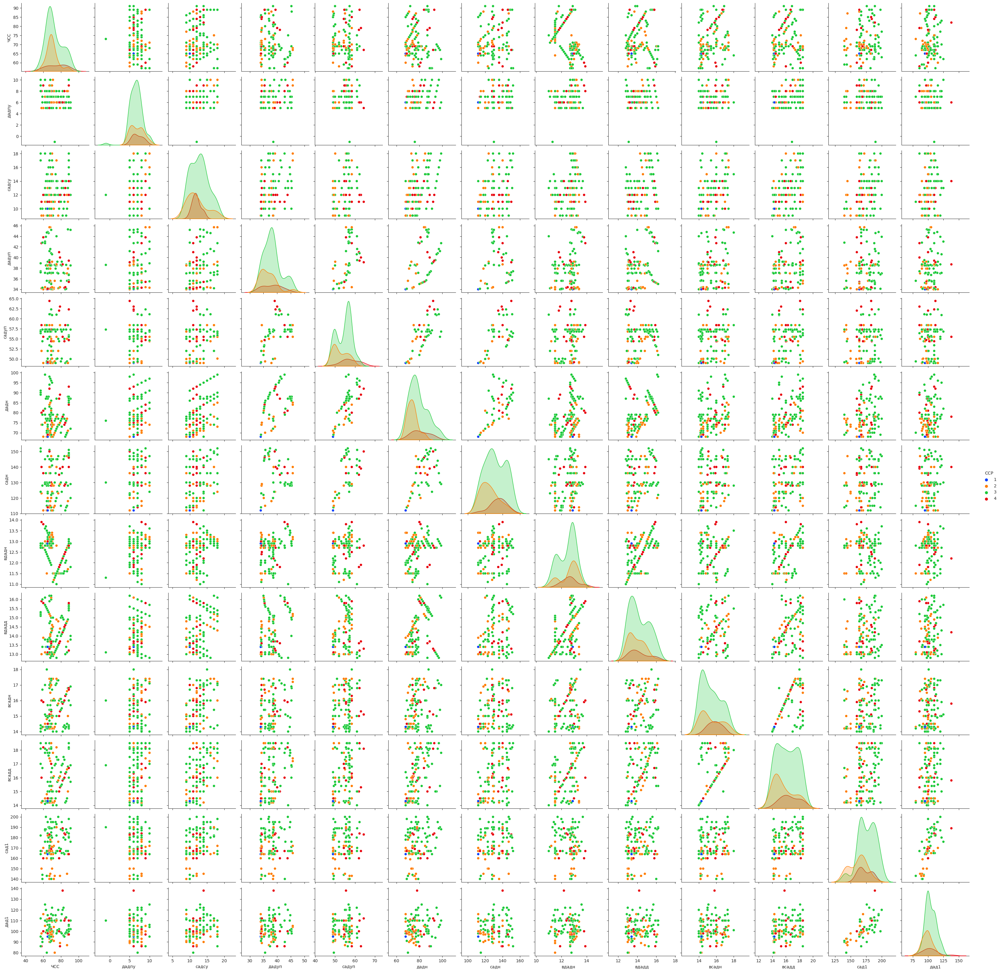

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'ЧСС',
'дадпу',
'садсу',
'дадуп',
'садуп',
'дадн',
'садн',
'вдадн',
'вдадд',
'всадн',
'всадд',
'сад1',
'дад1',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

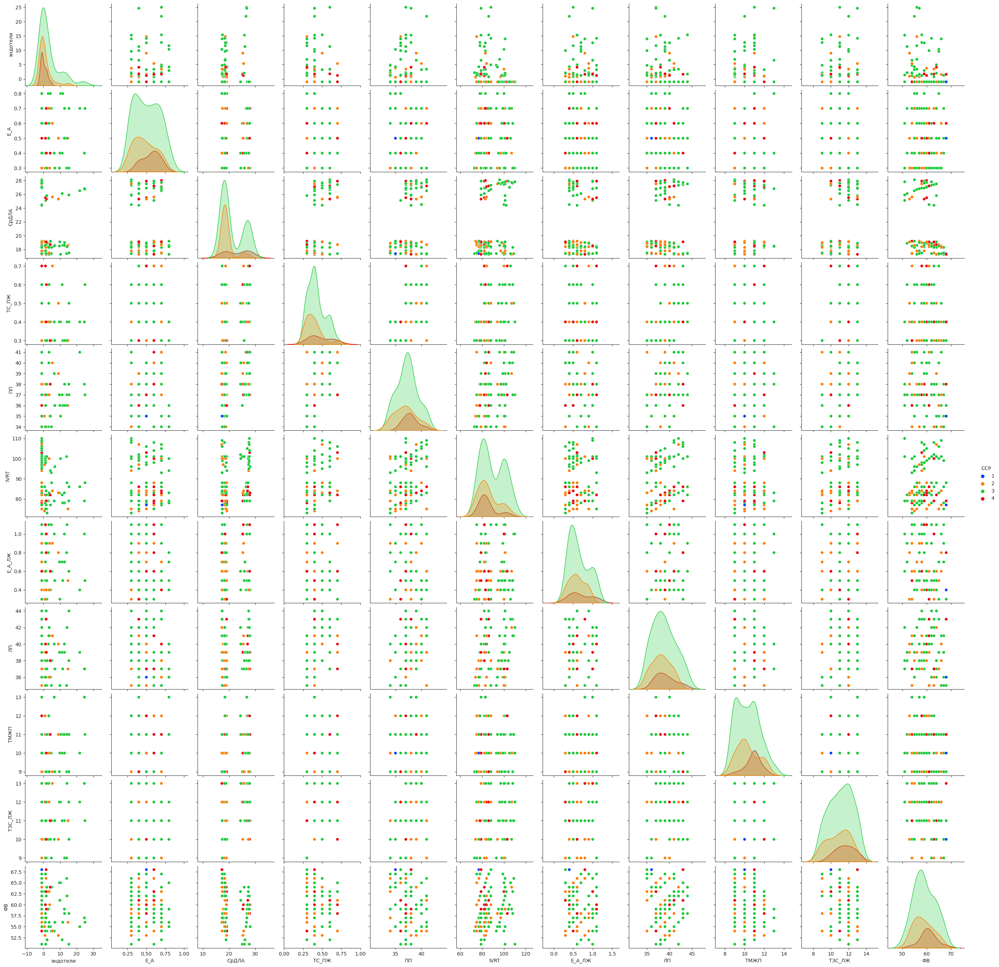

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'эндотели',
'E_A',
'СрДЛА',
'ТС_ПЖ',
'ПП',
'IVRT',
'E_A_ЛЖ',
'ЛП',
'ТМЖП',
'ТЗС_ЛЖ',
'ФВ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

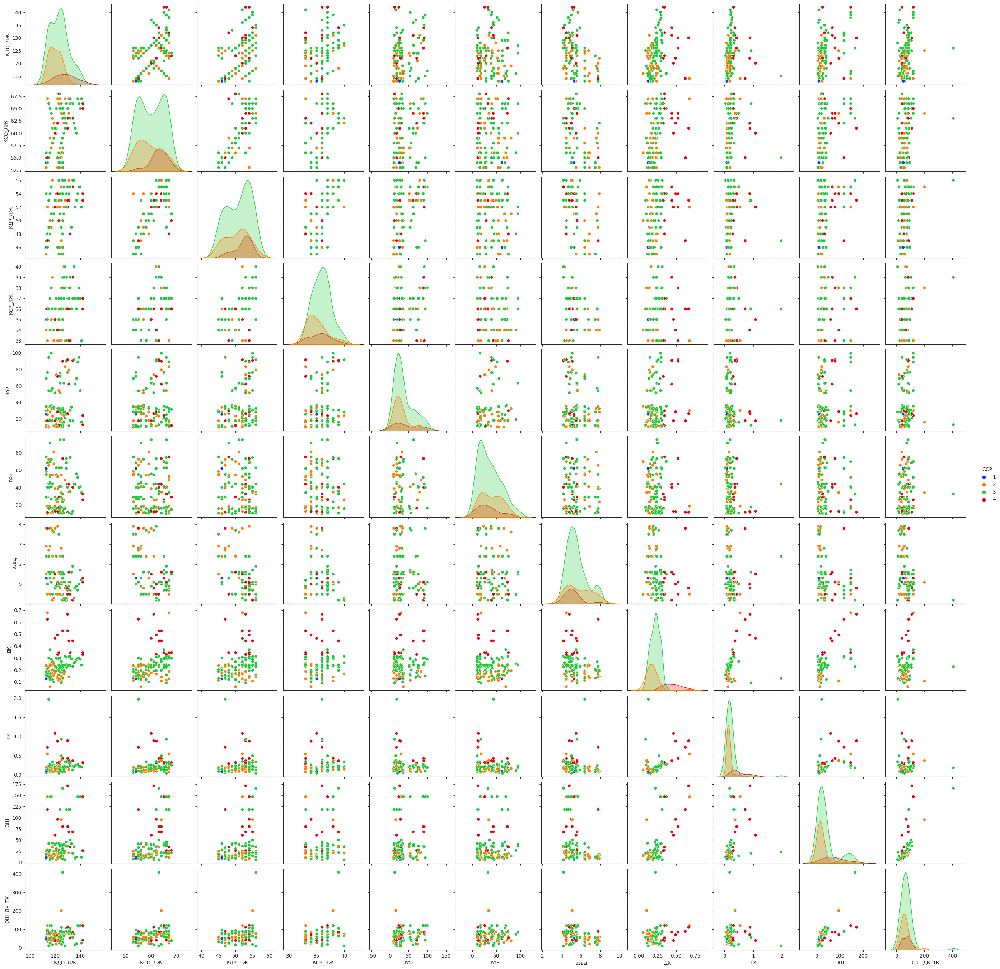

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'КДО_ЛЖ',
'КСО_ЛЖ',
'КДР_ЛЖ',
'КСР_ЛЖ',
'no2',
'no3',
'эзвд',
'ДК',
'ТК',
'ОШ',
'ОШ_ДК_ТК',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

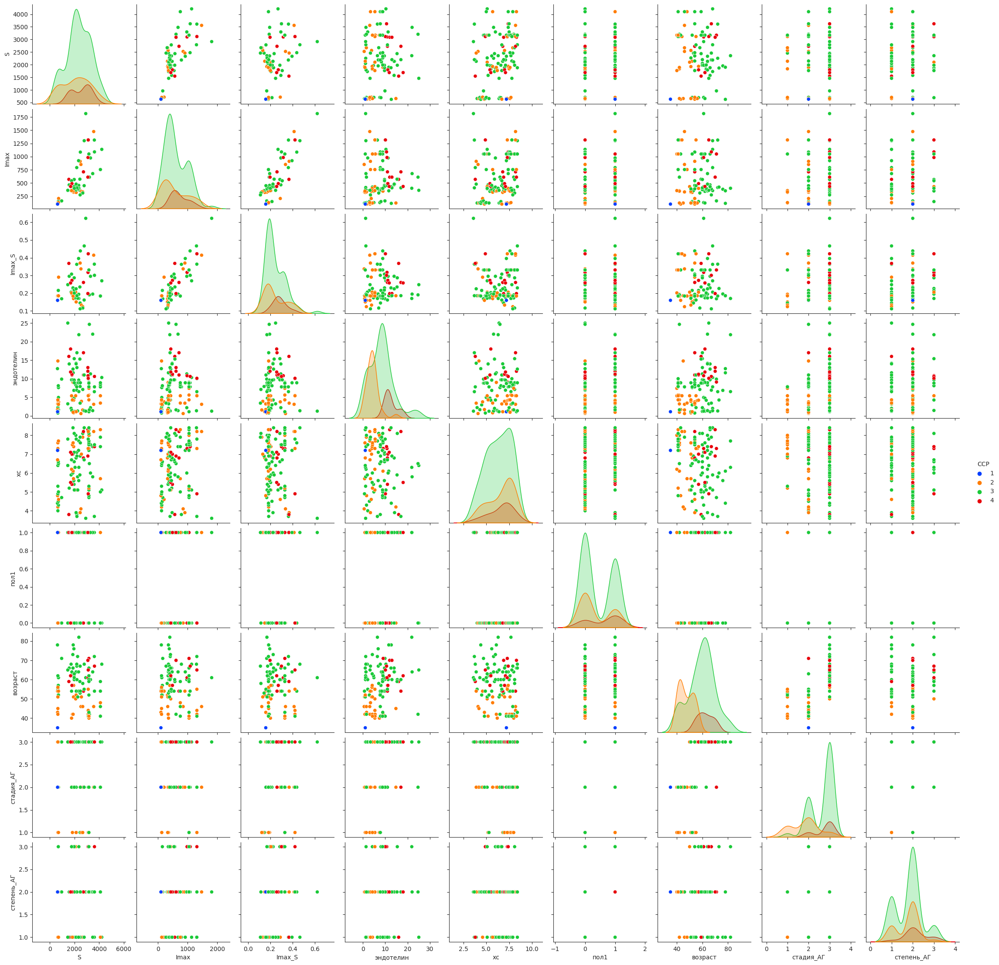

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'S',
'Imax',
'Imax_S',
'эндотелин',
'хс',
'пол1',
'возраст',
'стадия_АГ',
'степень_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

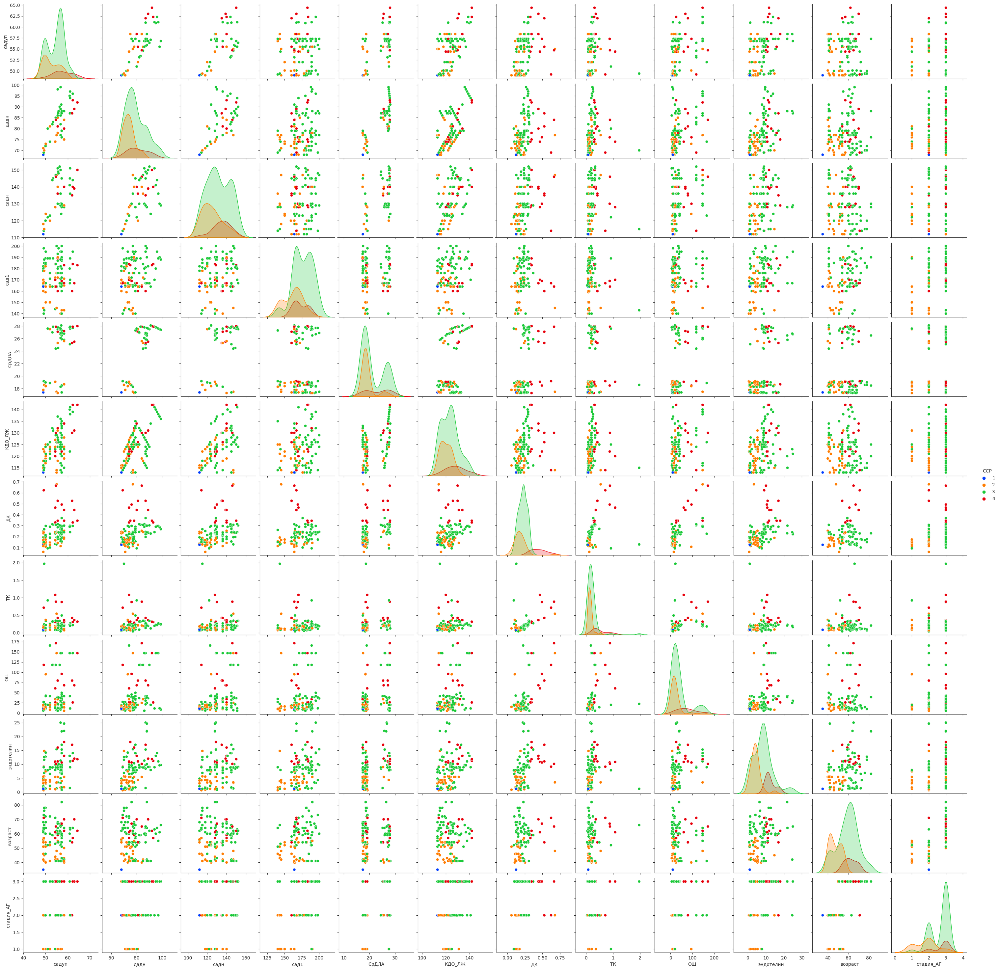

In [ ]:
sns.set_style("ticks")
sns.pairplot(data_1_2[[
'садуп',
'дадн',
'садн',
'сад1',
'СрДЛА',
'КДО_ЛЖ',
'ДК',
'ТК',
'ОШ',
'эндотелин',
'возраст',
'стадия_АГ',

'ССР'
                   ]],hue = 'ССР',diag_kind = "kde",kind = "scatter",palette = "bright")
plt.show()

Группы 1, 2 имеют существенные различия во взаимосвязи параметров. Вероятно, можно анализировать разными моделями. Обратить внимание на СрДЛА.